In [7]:

import numpy as np
import torch
import random
from collections import deque
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import datetime
import pickle
import math
import matplotlib.pyplot as plt

In [8]:
def plot_learning_curve(x, scores, figure_file):
    running_avg_score = np.zeros(len(scores))
    for i in range(len(running_avg_score)):
        running_avg_score[i] = np.mean(scores[max(0, i-100):(i+1)])
    plt.plot(x, running_avg_score, '-b')
    plt.title('Média móvel das últimas 100 pontuações')
    plt.savefig(figure_file)

def plot_success_curve(x, successes, figure_file):
    running_success_rate = np.zeros(len(successes))
    for i in range(len(running_success_rate)):
        running_success_rate[i] = np.mean(successes[max(0, i-50):(i+1)])
    plt.plot(x, running_success_rate, '-g')
    plt.title('Taxa de sucesso dos últimos 50 episódios')
    plt.savefig(figure_file)

def plot_step_curve(x, steps, figure_file):
    running_step_avg = np.zeros(len(steps))
    for i in range(len(running_step_avg)):
        running_step_avg[i] = np.mean(steps[max(0, i-200):(i+1)])
    plt.plot(x, running_step_avg, '-g')
    plt.title('Média móvel da duração dos últimos 200 episódios')
    plt.savefig(figure_file)

In [9]:
import mujoco
import mediapy as media
import random

class MujocoEnv1_0:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 9
        self.name = "MujocoEnv-v1-0"
        self.theta1 = 0
        self.theta2 = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.05
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.data.qpos[0:3] = [-1,-1,2.5]
        self.data.qvel[0:3] = [2.75,1,3]
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        return (theta1,theta2,x0,y0,z0,vx0,vy0,vz0)
    
    def calculaTarget(self):
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        tempo_queda = (vz0+np.sqrt(np.abs(vz0**2+2*9.8*(z0-0.589))))/9.8
        targetx = x0 + tempo_queda*vx0
        targety = y0 + tempo_queda*vy0
        return targetx, targety
    def calculaDistanciaTarget(self, targetx, targety):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-targetx)**2 + (self.data.geom_xpos[9,1].copy()-targety)**2)
    def calculaDistancia(self):
        xo,yo,zo = self.data.geom_xpos[1].copy()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return np.sqrt((xo-xc)**2+(yo-yc)**2+(zo-zc)**2)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget(*self.calculaTarget())
        reward = -5*distancia
        if self.data.time > 3 or self.data.qpos[2] < 0.2:
            done = True
        if self.calculaDistancia() < 0.05:
            done = True
            reward += 200
            print('success')
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        return (theta1,theta2,x0,y0,z0,vx0,vy0,vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget(*self.calculaTarget())
        reward = -10*distancia**2
        if self.data.time > 3 or self.data.qpos[2] < 0.2:
            done = True
        if self.calculaDistancia() < 0.05:
            done = True
            reward += 200
            print('success')
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        return (theta1,theta2,x0,y0,z0,vx0,vy0,vz0), reward, done

class MujocoEnv1_1:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 4
        self.action_dim = 9
        self.name = "MujocoEnv-v1-1"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)

        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        return (xc,yc,self.targetx,self.targety)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

class MujocoEnv1_2:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 4
        self.action_dim = 9
        self.name = "MujocoEnv-v1-2"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)

        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.targetx,self.targety)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.targetx,self.targety), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.targetx,self.targety), reward, done

class MujocoEnv0_0:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 4
        self.action_dim = 9
        self.name = "MujocoEnv-v0-0"
        self.theta1 = 0
        self.theta2 = 0
        self.targetx = 0
        self.targety = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.05
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        xc,yc,zc = self.data.geom_xpos[9].copy()
        ang = random.uniform(-np.pi,np.pi)
        r = random.uniform(1,1.7)
        self.targetx = r*np.sin(ang)
        self.targety = r*np.cos(ang)
        return (xc,yc,self.targetx,self.targety)
    
    def calculaDistanciaTarget(self, targetx, targety):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-targetx)**2 + (self.data.geom_xpos[9,1].copy()-targety)**2)
    
    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget(self.targetx,self.targety)
        reward = -2*distancia -2
        if self.data.time > 5:
            done = True
        if distancia < 0.15:
            done = True
            reward += 200
            print('success')
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget(self.targetx,self.targety)
        reward = -2*distancia -2
        if self.data.time > 5:
            done = True
        if distancia < 0.15:
            done = True
            reward += 200
            print('success')
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

class MujocoEnv2_0:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 9
        self.name = "MujocoEnv-v2-0"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        print(self.data)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1
        self.tfin = 0

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
            self.tfin = self.data.time
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < 0.05:
            done = True
            self.tfin = self.data.time
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

class MujocoEnv2_1:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 9
        self.name = "MujocoEnv-v2-1"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.dist = 0.45
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1
        self.tfin = 0

        self.angle = 0
        self.radius = 0  

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def setNextDistancia(self):
        if self.dist>0.06:
            self.dist = self.dist*0.8

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def getBolaFixa(self):
        self.x0 = self.radius*np.cos(self.angle)
        self.y0 = self.radius*np.sin(self.angle)
        self.z0 = 2.5
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 2.5
        self.calculaTarget()

    def variaPos(self,radius,angle):
        self.radius = radius
        self.angle = angle

    def resetFixo(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getBolaFixa()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        self.dist = 0.08
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 2*action[0]
        omega2 = 2*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.dist:
            done = True
            reward += 200
            print('success')
            self.tfin = self.data.time
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 2*action[0]
        omega2 = 2*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.dist:
            done = True
            self.tfin = self.data.time
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

class MujocoEnv2_2:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 9
        self.name = "MujocoEnv-v2-2"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.distlist = [1.6,0.8,0.4,0.06]
        self.distcount = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1
        self.tfin = 0
        self.successes = 0

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getGoodBola()
        self.calculaTarget()
        d = self.calculaDistanciaTarget()
        self.distlist = [0.75*d,0.5*d,0.25*d,0.06]
        if d < 0.06: self.distlist = [0.06]
        self.distcount = 0
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.distlist[self.distcount]:
            self.distcount += 1
            reward += 100
            self.successes += 1
        if self.distcount == len(self.distlist):
            done = True
            reward += 100
            print('success')
            self.tfin = self.data.time
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            ...
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.distlist[self.distcount]:
            self.distcount += 1
            reward += 100
            self.successes += 1
        if self.distcount == len(self.distlist):
            done = True
            reward += 100
            print('success')
            self.tfin = self.data.time
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

In [10]:
MODEL_FILE = "./ddqn_mujoco_model"
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class SumTree:
    write = 0

    def __init__(self, capacity):
        self.capacity = capacity
        self.tree = np.zeros(2 * capacity - 1)
        self.data = np.zeros(capacity, dtype=object)
        self.n_entries = 0

    # update to the root node
    def _propagate(self, index, change):
        parent = (index - 1) // 2
        self.tree[parent] += change
        if parent != 0:
            self._propagate(parent, change)

    # find sample on leaf node
    def _retrieve(self, index, s):
        left = 2 * index + 1
        right = left + 1
        if left >= len(self.tree):
            return index
        if s <= self.tree[left]:
            return self._retrieve(left, s)
        else:
            return self._retrieve(right, s - self.tree[left])

    def total(self):
        return self.tree[0]

    # store priority and sample
    def add(self, p, data):
        index = self.write + self.capacity - 1
        self.data[self.write] = data
        self.update(index, p)
        self.write += 1
        if self.write >= self.capacity:
            self.write = 0
        if self.n_entries < self.capacity:
            self.n_entries += 1

    # update priority
    def update(self, index, p):
        change = p - self.tree[index]
        self.tree[index] = p
        self._propagate(index, change)

    # get priority and sample
    def get(self, s):
        index = self._retrieve(0, s)
        dataIndex = index - self.capacity + 1
        return (index, self.tree[index], self.data[dataIndex])

class PrioritizedExperienceReplay:
    def __init__(self, buffer_size):
        self.tree = SumTree(buffer_size)
        self.e = 0.01  # Avoids priority 0
        self.alpha = 0.5 # Priority control
        self.beta = 0.3 # bias compensation
        self.beta_increment = 0.00001

    def _get_priority(self, error):
        return (np.abs(error) + self.e) ** self.alpha
    
    def add(self, error, sample):
        if isinstance(error, torch.Tensor):
            error_cpu = error.detach().cpu().numpy() 
        else:
            error_cpu = np.array(error)
        
        p = self._get_priority(error_cpu)
        self.tree.add(p, sample)

    '''# Add a transition to the memory by basic SARNS convention. 
    def store_transition(self, state, action, reward, new_state, done):
        # If buffer is abuot to overflow, begin rewriting existing memory? 
        self.buffer.append((state, action, reward, new_state, done))'''

    # Sample only the memory that has been stored. Samples BATCH
    # amount of samples. 
    '''def sample(self):
        sample = random.sample(self.buffer, BATCH_SIZE)
        states, actions, rewards, next_states, dones = zip(*sample)
        #print ("actions",actions)
        states = torch.tensor(states).float().to(DEVICE)
        actions = torch.stack(actions).long().to(DEVICE)
        rewards = torch.from_numpy(np.array(rewards, dtype=np.float32).reshape(-1, 1)).to(DEVICE)
        next_states = torch.tensor(next_states).float().to(DEVICE)
        dones = torch.from_numpy(np.array(dones, dtype=np.uint8).reshape(-1, 1)).float().to(DEVICE)
        return (states, actions, rewards, next_states, dones)'''
    
    def sample(self, n):
        batch = []
        indexes = []
        segment = self.tree.total() / n
        priorities = []

        self.beta = np.min([1., self.beta + self.beta_increment])

        for i in range(n):
            a = segment * i
            b = segment * (i + 1)

            s = random.uniform(a, b)
            (index, p, data) = self.tree.get(s)
            priorities.append(p)
            batch.append(data)
            indexes.append(index)

        sampling_probabilities = priorities / self.tree.total()
        is_weight = np.power(self.tree.n_entries * sampling_probabilities, -self.beta)
        is_weight /= is_weight.max()

        return batch, indexes, is_weight
    
    def update(self, index, error):
        p = self._get_priority(error)
        self.tree.update(index, p)

class QNetwork(nn.Module):
    def __init__(self, state_dim, action_dim):
        super(QNetwork, self).__init__()
        # Make a simple 3 later linear network
        self.l1 = nn.Linear(state_dim, 512)
        self.l2 = nn.Linear(512, 256)
        self.l3 = nn.Linear(256, action_dim)
        #self.max_action = max_action

    def forward(self, state):
        x = F.relu(self.l1(state))
        x = F.relu(self.l2(x))
        #x = self.max_action * torch.tanh(self.l3(x))
        return self.l3(x)

class Agent():
    # Initialize the agent
    def __init__(self, state_dim, action_dim):
        self.memory = PrioritizedExperienceReplay(MEM_SIZE)
        self.action_dim = action_dim
        self.main_model = QNetwork(state_dim, action_dim).to(DEVICE)
        self.target_model = QNetwork(state_dim, action_dim).to(DEVICE)
        self.optimizer = optim.Adam(self.main_model.parameters(), lr=LR)
        self.eps = 1
        self.eps_decay = 0.999
        self.eps_min = 0.01

        # Target model will be a copy of the main model and will not be trained
        self.target_model.load_state_dict(self.main_model.state_dict())
        self.target_model.eval()

    # Agent saves its experiences and learn
    def step(self, state, action, reward, new_state, done):
        state = torch.tensor(state, dtype=torch.float32).to(DEVICE)
        new_state = torch.tensor(new_state, dtype=torch.float32).to(DEVICE)

        q_eval = self.main_model(state)[action]
        q_next = self.target_model(new_state).detach().max(0)[0]
        q_target = reward + GAMMA*(q_next) *(1-done)

        td_error = q_eval - q_target
        self.memory.add(td_error, (state, action, reward, new_state, done))

        # Agent will only learn when there are enough experiences
        if self.memory.tree.n_entries > BATCH_SIZE:
            self.learn()

    # Agent learns
    def learn(self):
        # Sample random minibatch of transitions from Experience Replay
        batch, indexes, is_weight = self.memory.sample(BATCH_SIZE)
        state, action, reward, new_state, done = zip(*batch)
        #print("state",state,len(state),"\n action",action,len(action))
        state = torch.stack([torch.tensor(s, dtype=torch.float32) for s in state]).to(DEVICE)
        action = torch.stack([torch.tensor(a, dtype=torch.int64) for a in action]).to(DEVICE)
        reward = torch.tensor(reward, dtype=torch.float32).to(DEVICE).unsqueeze(1)
        new_state = torch.stack([torch.tensor(ns, dtype=torch.float32) for ns in new_state]).to(DEVICE)
        done = torch.tensor(done, dtype=torch.float32).to(DEVICE)
      
        #print ("target",self.main_model(state))
        # Computes Q(s_{curr},a') then chooses columns of actions that were taken for each batch
        q_eval = self.main_model(state).gather(1,action.unsqueeze(1))
        #print("a",self.main_model(state)[1],action[1],q_eval[1])

        # Clone the model and use it to generate Q learning targets for the main model
        # Also predicts the max Q value for the next state
        #print ("target",self.main_model(state))
        q_next = self.target_model(new_state).detach().max(1)[0].unsqueeze(1)
        #print("b",self.target_model(new_state)[1],q_next[1])

        # Q learning targets = r if next state is terminal or
        # Q learning targets = r + GAMMA*(Q(s_{next},a')) if next state is not terminal
        q_target = reward + GAMMA*(q_next) *(1-done)
        q_target = q_target[:, :1]

        '''print("REWARD", reward)
        print("Q_Next", q_next)        

        print("Q_EVAL", q_eval)
        print("Q_TARGET", q_target)'''

        td_errors = (q_eval - q_target).squeeze(-1)
        #print("TD_ERRORS", td_errors)

        # Update the priorities in PER
        td_errors_abs = td_errors.abs().cpu().detach().numpy()
        #print("AAAA",td_errors_abs)
        for i in range(BATCH_SIZE):
            self.memory.update(indexes[i], td_errors_abs[i])  # Atualiza com o valor absoluto do erro TD

        # Compute unbiased loss
        is_weight = torch.tensor(is_weight, dtype=torch.float32).to(DEVICE)
        loss = (is_weight * (td_errors ** 2)).mean()

        # Stochastic gradient descent on the loss function and does backpropragation
        self.optimizer.zero_grad()
        loss.backward()
        for param in self.main_model.parameters():
            # Clip the error term to be between -1 and 1
            param.grad.data.clamp_(-1,1)
        self.optimizer.step()

    def decrement_epsilon(self):
        self.eps *= self.eps_decay 
        if self.eps < self.eps_min:
            self.eps = self.eps_min

    # Action chosen is either a random action or based on the Bellman Equation
    def take_action(self,action):
        ternary = np.base_repr(action, base=3)
        ternary = ternary.zfill(2)
        #print(enumerate(ternary))
        action_array = np.zeros(2)
        for i,n in enumerate(ternary):
            #print("n",n)
            action_array[i] = (int(n) - 1)
        #print ("oi",action_array)
        return action_array
    
    def choose_action(self, state):
        # With probability EPSILON, select a random action
        #print (state)
        if np.random.random() < self.eps:
            #return torch.from_numpy(self.action_space.sample())
            acao = random.randint(0,8)
            
        # Otherwise select the action with the highest Q value
        else: 
            #print (state)
            state = torch.FloatTensor(np.array(state).reshape(1,-1)).to(DEVICE)
            #print ("state",state)
            
            # action that maximizes Q*(s',a';THETA)  
            with torch.no_grad():
                acao = self.main_model(state).max(1)[1].item()
                #print ("escolhe",self.main_model(state),acao)
        return acao
    
    def soft_update_target_model(self, tau):
        target_model_state_dict = self.target_model.state_dict()
        main_model_state_dict = self.main_model.state_dict()
        
        for key in main_model_state_dict:
            target_model_state_dict[key] = main_model_state_dict[key] * tau + target_model_state_dict[key] * (1 - tau)
        
        self.target_model.load_state_dict(target_model_state_dict)


def save_model(model, path):
    torch.save(model.state_dict(), path)

def load_model(model, path):
    model.load_state_dict(torch.load(path))
    return model

def replay_actions(env, actions):
    done = False
    state = env.reset()
    for action in actions:
        env.render()
        env.step(action)
    env.close()

def store_actions(actions, path):
    actions_file = open(path,'wb')
    pickle.dump(actions, actions_file)
    actions_file.close()

def load_actions(path):
    actions_file = open(path,'rb')
    actions = pickle.load(actions_file)
    actions_file.close()

    return actions

In [11]:
# Hyperparameters
N_GAMES = 10001
MEM_SIZE = 100000
BATCH_SIZE = 64
TARGET_UPDATE = 4
GAMMA = 0.99
TAU = 0.005
LR = 1e-4


eps: 0.999
game: 0
steps 5.012499999999942
reward: -240.28350928778468
max reward: -240.28350928778468 at game 0
average score for the last 100 games: -240.28350928778468
time: 0.389549 seconds



/tmp/ipykernel_9772/4109629081.py:176: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  state = torch.stack([torch.tensor(s, dtype=torch.float32) for s in state]).to(DEVICE)
/tmp/ipykernel_9772/4109629081.py:177: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  action = torch.stack([torch.tensor(a, dtype=torch.int64) for a in action]).to(DEVICE)
/tmp/ipykernel_9772/4109629081.py:179: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  new_state = torch.stack([torch.tensor(ns, dtype=torch.float32) for ns in new_state]).to(DEVICE)


eps: 0.998001
game: 1
steps 5.012499999999942
reward: -492.07453944869286
max reward: -240.28350928778468 at game 0
average score for the last 100 games: -366.17902436823874
time: 0.476481 seconds

eps: 0.997002999
game: 2
steps 5.012499999999942
reward: -504.4755058527406
max reward: -240.28350928778468 at game 0
average score for the last 100 games: -412.27785152973934
time: 0.500834 seconds

eps: 0.996005996001
game: 3
steps 5.012499999999942
reward: -503.9099643300661
max reward: -240.28350928778468 at game 0
average score for the last 100 games: -435.185879729821
time: 0.484286 seconds

eps: 0.995009990004999
game: 4
steps 5.012499999999942
reward: -563.9603967306903
max reward: -240.28350928778468 at game 0
average score for the last 100 games: -460.9407831299948
time: 0.527147 seconds

eps: 0.994014980014994
game: 5
steps 5.012499999999942
reward: -346.2071304615177
max reward: -240.28350928778468 at game 0
average score for the last 100 games: -441.8185076852487
time: 0.548599 

eps: 0.6063789448611848
game: 499
steps 5.012499999999942
reward: -721.0401974625277
max reward: 189.44506650452487 at game 488
average score for the last 100 games: -289.49587899349996
time: 0.809296 seconds

eps: 0.6057725659163237
game: 500
steps 5.012499999999942
reward: -394.68240264239574
max reward: 189.44506650452487 at game 488
average score for the last 100 games: -291.10566802100624
time: 0.515515 seconds

eps: 0.6051667933504074
game: 501
steps 5.012499999999942
reward: -244.05792221333172
max reward: 189.44506650452487 at game 488
average score for the last 100 games: -294.33524488613284
time: 0.519529 seconds

eps: 0.6045616265570569
game: 502
steps 5.012499999999942
reward: -211.70344152725158
max reward: 189.44506650452487 at game 488
average score for the last 100 games: -287.8792653465506
time: 0.507291 seconds

eps: 0.6039570649304998
game: 503
steps 5.012499999999942
reward: -307.4401811121666
max reward: 189.44506650452487 at game 488
average score for the last 100

eps: 0.3676954247709635
game: 999
steps 5.012499999999942
reward: -521.1313828508336
max reward: 189.44506650452487 at game 488
average score for the last 100 games: -191.8483136580439
time: 0.861536 seconds

eps: 0.36732772934619257
game: 1000
steps 5.012499999999942
reward: -229.57385695957444
max reward: 189.44506650452487 at game 488
average score for the last 100 games: -191.3161105702662
time: 0.550951 seconds

eps: 0.3669604016168464
game: 1001
steps 5.012499999999942
reward: -136.41247768290347
max reward: 189.44506650452487 at game 488
average score for the last 100 games: -189.71652609277632
time: 0.565539 seconds

eps: 0.3665934412152296
game: 1002
steps 5.012499999999942
reward: -338.24229895277784
max reward: 189.44506650452487 at game 488
average score for the last 100 games: -192.99205922384073
time: 0.506159 seconds

eps: 0.3662268477740143
game: 1003
steps 5.012499999999942
reward: -308.6275440409019
max reward: 189.44506650452487 at game 488
average score for the last

eps: 0.22296276370290227
game: 1499
steps 5.012499999999942
reward: -330.7551719358986
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -178.63856177535214
time: 0.848896 seconds

eps: 0.22273980093919937
game: 1500
steps 5.012499999999942
reward: -150.95777163836794
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -178.31624052936502
time: 0.503118 seconds

eps: 0.22251706113826017
game: 1501
steps 5.012499999999942
reward: -438.03621346468094
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -182.65458244728026
time: 0.524498 seconds

success
eps: 0.2222945440771219
game: 1502
steps 1.7059999999998676
reward: 152.38519870858724
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -181.42879957971493
time: 0.159611 seconds

eps: 0.22207224953304477
game: 1503
steps 5.012499999999942
reward: -170.92910340638713
max reward: 193.44620297312196 at game 1335
averag

eps: 0.1351999253974994
game: 1999
steps 5.012499999999942
reward: -425.3753547077994
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -187.33041819023015
time: 0.931664 seconds

eps: 0.13506472547210188
game: 2000
steps 5.012499999999942
reward: -162.6372106116071
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -186.83768861977876
time: 0.587163 seconds

eps: 0.1349296607466298
game: 2001
steps 5.012499999999942
reward: -226.6755643742877
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -187.13877860111344
time: 0.518565 seconds

eps: 0.13479473108588316
game: 2002
steps 5.012499999999942
reward: -313.73185763786944
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -188.11923562251297
time: 0.568709 seconds

eps: 0.13465993635479728
game: 2003
steps 5.012499999999942
reward: -216.15123517427367
max reward: 193.44620297312196 at game 1335
average score for

eps: 0.08198238810784661
game: 2499
steps 5.012499999999942
reward: -479.5106306640798
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -187.39649409360266
time: 0.95592 seconds

eps: 0.08190040571973876
game: 2500
steps 5.012499999999942
reward: -263.9145652981189
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -188.30955205832214
time: 0.664098 seconds

eps: 0.08181850531401902
game: 2501
steps 5.012499999999942
reward: -226.87639457627898
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -188.30127358177805
time: 0.622893 seconds

eps: 0.081736686808705
game: 2502
steps 5.012499999999942
reward: -171.23447243893284
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -190.84796118981197
time: 0.617332 seconds

eps: 0.08165495012189629
game: 2503
steps 5.012499999999942
reward: -223.1229977145771
max reward: 193.44620297312196 at game 1335
average score for 

eps: 0.04971239399803625
game: 2999
steps 5.012499999999942
reward: -657.6516039807632
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -161.9214189340625
time: 0.786868 seconds

eps: 0.049662681604038215
game: 3000
steps 5.012499999999942
reward: -163.6024605112623
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -161.41221968909787
time: 0.520028 seconds

eps: 0.04961301892243418
game: 3001
steps 5.012499999999942
reward: -182.37821098664807
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -161.47452254311696
time: 0.493137 seconds

eps: 0.04956340590351174
game: 3002
steps 5.012499999999942
reward: -178.89869110595313
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -161.09397818850329
time: 0.534461 seconds

eps: 0.04951384249760823
game: 3003
steps 5.012499999999942
reward: -183.32807742973256
max reward: 193.44620297312196 at game 1335
average score 

eps: 0.030144549019052724
game: 3499
steps 5.012499999999942
reward: -889.3485583718366
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -163.28213693798796
time: 0.820625 seconds

eps: 0.030114404470033673
game: 3500
steps 5.012499999999942
reward: -239.5760438132729
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -163.9253054817047
time: 0.530071 seconds

eps: 0.030084290065563637
game: 3501
steps 5.012499999999942
reward: -227.09776994250507
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -164.7082539312076
time: 0.553907 seconds

eps: 0.030054205775498073
game: 3502
steps 5.012499999999942
reward: -176.03965844717143
max reward: 193.44620297312196 at game 1335
average score for the last 100 games: -166.98850896499735
time: 0.5427 seconds

success
eps: 0.030024151569722574
game: 3503
steps 2.607500000000038
reward: 74.32504331513566
max reward: 193.44620297312196 at game 1335
average

eps: 0.018279019827489446
game: 3999
steps 5.012499999999942
reward: -250.33978149273884
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -125.49219916775037
time: 0.939582 seconds

eps: 0.018260740807661956
game: 4000
steps 5.012499999999942
reward: -157.54786504740295
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -125.07296584252907
time: 0.597304 seconds

eps: 0.018242480066854295
game: 4001
steps 5.012499999999942
reward: -241.72615925843428
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -125.41980764001863
time: 0.528923 seconds

eps: 0.01822423758678744
game: 4002
steps 5.012499999999942
reward: -150.3738500280226
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -125.56132720450769
time: 0.620548 seconds

eps: 0.01820601334920065
game: 4003
steps 5.012499999999942
reward: -166.12843353859418
max reward: 195.79209562840887 at game 3990
average sc

eps: 0.011084012756089733
game: 4499
steps 5.012499999999942
reward: -668.9013909397041
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -141.90784738269073
time: 0.822549 seconds

eps: 0.011072928743333644
game: 4500
steps 5.012499999999942
reward: -135.91471476569717
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -141.15783731105049
time: 0.572622 seconds

eps: 0.01106185581459031
game: 4501
steps 5.012499999999942
reward: -140.32008451162162
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -140.12599887956048
time: 0.59041 seconds

eps: 0.01105079395877572
game: 4502
steps 5.012499999999942
reward: -133.10107412725202
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -139.9534824805373
time: 0.576852 seconds

eps: 0.011039743164816944
game: 4503
steps 5.012499999999942
reward: -207.69460574800374
max reward: 195.79209562840887 at game 3990
average scor

eps: 0.01
game: 4999
steps 5.012499999999942
reward: -643.4808301353006
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -138.15289556987523
time: 0.88713 seconds

eps: 0.01
game: 5000
steps 5.012499999999942
reward: -248.8951298350681
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -141.76506176334678
time: 0.689154 seconds

eps: 0.01
game: 5001
steps 5.012499999999942
reward: -171.33124463173365
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -142.1663097266901
time: 0.602918 seconds

eps: 0.01
game: 5002
steps 5.012499999999942
reward: -190.7402091475771
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -142.4883803927361
time: 0.55731 seconds

eps: 0.01
game: 5003
steps 5.012499999999942
reward: -159.66128509569182
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -145.519711945369
time: 0.599997 seconds

eps: 0.01
game

eps: 0.01
game: 5499
steps 5.012499999999942
reward: -262.7806802754288
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -129.72035312747778
time: 0.868729 seconds

eps: 0.01
game: 5500
steps 5.012499999999942
reward: -139.12973870204618
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -129.25779180153893
time: 0.696449 seconds

eps: 0.01
game: 5501
steps 5.012499999999942
reward: -147.61012433349123
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -129.01895006221335
time: 0.552017 seconds

success
eps: 0.01
game: 5502
steps 3.2075000000002385
reward: 94.9689477617233
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -126.71455047868214
time: 0.335846 seconds

eps: 0.01
game: 5503
steps 5.012499999999942
reward: -129.94915780347642
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -129.34925384454758
time: 0.713636 seconds



eps: 0.01
game: 5999
steps 5.012499999999942
reward: -186.9280732508124
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -127.5283077983398
time: 0.848333 seconds

success
eps: 0.01
game: 6000
steps 3.307500000000272
reward: 48.68130674600977
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -125.44088647950068
time: 0.355993 seconds

eps: 0.01
game: 6001
steps 5.012499999999942
reward: -170.45095079589015
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -125.8434597608002
time: 0.518178 seconds

eps: 0.01
game: 6002
steps 5.012499999999942
reward: -190.56034434170346
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -128.43203349362378
time: 0.649787 seconds

eps: 0.01
game: 6003
steps 5.012499999999942
reward: -147.25195272387074
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -128.4889630189069
time: 0.691704 seconds

eps

eps: 0.01
game: 6499
steps 5.012499999999942
reward: -381.65724332970973
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -97.53385498445328
time: 0.859067 seconds

success
eps: 0.01
game: 6500
steps 0.7009999999999782
reward: 174.51398306754533
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -94.35286251815613
time: 0.069038 seconds

eps: 0.01
game: 6501
steps 5.012499999999942
reward: -232.68517468557357
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -86.56376649435595
time: 0.515786 seconds

success
eps: 0.01
game: 6502
steps 3.4075000000003053
reward: 104.82236436206665
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -83.85778160153845
time: 0.368685 seconds

eps: 0.01
game: 6503
steps 5.012499999999942
reward: -156.72463392835465
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -83.87975828651997
time: 0.517684 sec

eps: 0.01
game: 6999
steps 5.012499999999942
reward: -249.14691185144324
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -143.26779053429917
time: 0.79082 seconds

eps: 0.01
game: 7000
steps 5.012499999999942
reward: -171.31540617205454
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -143.53213511951722
time: 0.51216 seconds

success
eps: 0.01
game: 7001
steps 3.807500000000439
reward: 91.11748399384052
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -140.3552182402897
time: 0.481037 seconds

eps: 0.01
game: 7002
steps 5.012499999999942
reward: -239.41428766603508
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -140.40364487400564
time: 0.532954 seconds

eps: 0.01
game: 7003
steps 5.012499999999942
reward: -181.8356381297857
max reward: 195.79209562840887 at game 3990
average score for the last 100 games: -143.96727417768602
time: 0.645582 seconds

suc

eps: 0.01
game: 7499
steps 5.012499999999942
reward: -501.02655501617375
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -119.72465110358382
time: 0.85392 seconds

eps: 0.01
game: 7500
steps 5.012499999999942
reward: -236.3665495434313
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -120.02431563439302
time: 0.543596 seconds

eps: 0.01
game: 7501
steps 5.012499999999942
reward: -121.78781496929817
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -122.4339409125841
time: 0.507014 seconds

eps: 0.01
game: 7502
steps 5.012499999999942
reward: -139.98727195052209
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -124.75996066021212
time: 0.512759 seconds

eps: 0.01
game: 7503
steps 5.012499999999942
reward: -138.6175441405307
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -124.83354742063263
time: 0.550113 seconds

eps: 0.01
game

eps: 0.01
game: 7999
steps 5.012499999999942
reward: -791.8305980532901
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -185.22985059679004
time: 0.784351 seconds

success
eps: 0.01
game: 8000
steps 4.51000000000022
reward: 27.961774390406504
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -183.5443307357461
time: 0.570332 seconds

success
eps: 0.01
game: 8001
steps 1.5049999999998898
reward: 142.08219189634073
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -180.7111226444683
time: 0.149641 seconds

eps: 0.01
game: 8002
steps 5.012499999999942
reward: -171.02340483307808
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -179.50890812444075
time: 0.711558 seconds

eps: 0.01
game: 8003
steps 5.012499999999942
reward: -143.341124084213
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -179.11501386488078
time: 0.544884 seconds

e

eps: 0.01
game: 8499
steps 5.012499999999942
reward: -239.49187063081195
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -171.43936938432057
time: 0.884046 seconds

success
eps: 0.01
game: 8500
steps 0.5000000000000003
reward: 187.02743431869695
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -164.57090075775068
time: 0.054023 seconds

eps: 0.01
game: 8501
steps 5.012499999999942
reward: -137.51961155331531
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -164.382181937041
time: 0.634172 seconds

eps: 0.01
game: 8502
steps 5.012499999999942
reward: -193.59514299891592
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -164.03014939464697
time: 0.64177 seconds

eps: 0.01
game: 8503
steps 5.012499999999942
reward: -449.4305983101175
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -166.8221383918209
time: 0.608249 seconds

success

eps: 0.01
game: 8999
steps 5.012499999999942
reward: -853.2724832348897
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -180.09698368119436
time: 0.863212 seconds

eps: 0.01
game: 9000
steps 5.012499999999942
reward: -128.18821063458253
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -178.1235257019168
time: 0.598882 seconds

eps: 0.01
game: 9001
steps 5.012499999999942
reward: -240.26690874418264
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -179.07616026832977
time: 0.611378 seconds

eps: 0.01
game: 9002
steps 5.012499999999942
reward: -531.5970069434883
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -180.81331856120744
time: 0.544246 seconds

success
eps: 0.01
game: 9003
steps 4.208500000000387
reward: 63.964867436073774
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -181.52269052145758
time: 0.438298 seconds

eps: 0

eps: 0.01
game: 9499
steps 5.012499999999942
reward: -402.77124140900145
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -239.14422362666588
time: 0.8269 seconds

eps: 0.01
game: 9500
steps 5.012499999999942
reward: -273.95704474722226
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -240.42927289400615
time: 0.571897 seconds

eps: 0.01
game: 9501
steps 5.012499999999942
reward: -314.85269015827015
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -240.76277603273735
time: 0.557413 seconds

eps: 0.01
game: 9502
steps 5.012499999999942
reward: -333.06752885831247
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -242.2095733452008
time: 0.565573 seconds

eps: 0.01
game: 9503
steps 5.012499999999942
reward: -138.89652496746865
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -240.4916431683771
time: 0.547547 seconds

eps: 0.01
game

eps: 0.01
game: 9999
steps 5.012499999999942
reward: -208.51611369190044
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -264.92272723638916
time: 0.779617 seconds

eps: 0.01
game: 10000
steps 5.012499999999942
reward: -143.03924260342157
max reward: 195.8027956775683 at game 7365
average score for the last 100 games: -263.64594258079063
time: 0.667536 seconds

Total time: 8510.49969 seconds


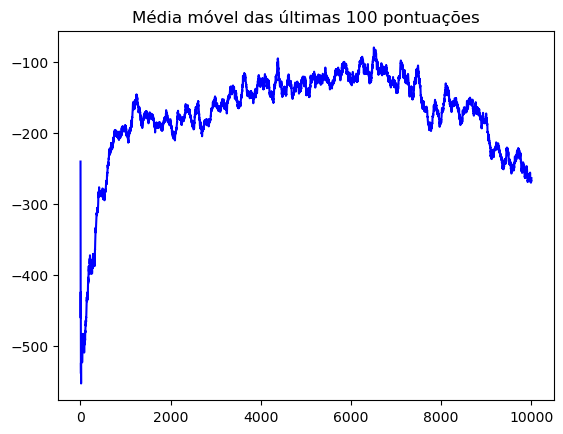

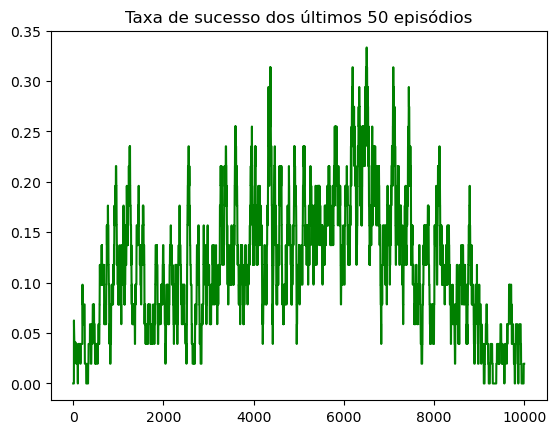

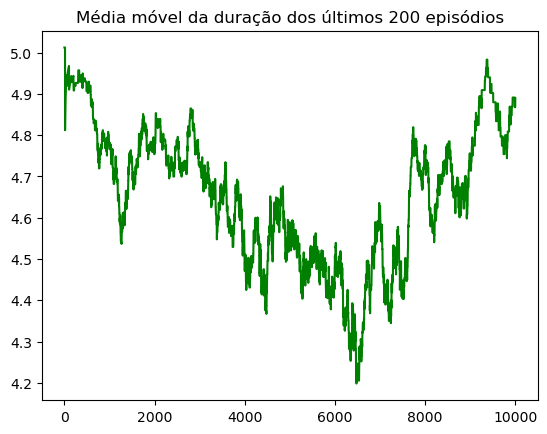

In [12]:
def main():
    plt.ion()
    env = MujocoEnv2_0()
    state_dim = env.state_dim
    action_dim = env.action_dim
    agent = Agent(state_dim, action_dim)

    load = input("load from model? [y/n]: ")
    
    filename = 'DDQN_mujoco'
    figure_file_score = 'plots/' + filename + '_score.png'
    figure_file_catchrate = 'plots/' + filename + '_catchrate.png'
    figure_file_steps = 'plots/' + filename + '_steps.png'

    if load == "y":
        agent.main_model = load_model(agent.main_model, MODEL_FILE)
        agent.target_model = load_model(agent.main_model, MODEL_FILE)
        actions = load_actions(MODEL_FILE+'_actions')
        agent.eps = agent.eps_min

    max_score = -10000
    max_game = 0
    scores = []
    start = datetime.datetime.now()
    
    step_history = []
    score_history = []
    success_history = []

    for game in range(N_GAMES):
        done = False
        score = 0
        success = 0
        observation = env.reset()
        #print(observation)
        game_actions = [] # actions taken during this game
        episode_start = datetime.datetime.now()

        if game%500 != 499:
            while not done:
                action = agent.choose_action(observation)
                next_observation, reward, done = env.step(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if reward > 0: success = 1
        else:
            while not done:
                action = agent.choose_action(observation)
                observation_, reward, done = env.rstep(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if reward > 0: success = 1
            media.show_video(env.frames, fps=env.framerate)

        if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)


        # Update variables each game
        agent.decrement_epsilon()
        episode_end = datetime.datetime.now()
        elapsed = episode_end - episode_start
        scores.append(score)
        avg_score = np.mean(scores[-100:])
        
        step_history.append(env.tfin)
        score_history.append(score)
        success_history.append(success)

        # Checks if the max score has been beaten
        if score > max_score:
            max_score = score
            max_game = game

            save_model(agent.main_model, MODEL_FILE)
            store_actions(game_actions, MODEL_FILE+'_actions')

        print("eps:",agent.eps)
        print('game:', game)
        print('steps',env.tfin)
        print('reward:', str(score))
        print("max reward:", str(max_score), "at game", str(max_game))
        print('average score for the last 100 games:', avg_score)
        print('time:', str(elapsed.total_seconds()),'seconds')
        print()

    # After going through N_GAMES
    end = datetime.datetime.now()
    elapsed = end - start

    print('Total time:',elapsed.total_seconds(), 'seconds')
    
    x = [i+1 for i in range(N_GAMES)]
    %matplotlib inline
    plt.figure('learning')
    plot_learning_curve(x, score_history, figure_file_score)
    plt.figure('catching')
    plot_success_curve(x, success_history, figure_file_catchrate)
    plt.figure('steps')
    plot_step_curve(x, step_history, figure_file_steps)

    scores_file = open(MODEL_FILE+'_scores','wb')
    pickle.dump(scores, scores_file)
    scores_file.close()

main()

/tmp/ipykernel_371395/4109629081.py:176: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  state = torch.stack([torch.tensor(s, dtype=torch.float32) for s in state]).to(DEVICE)
/tmp/ipykernel_371395/4109629081.py:177: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  action = torch.stack([torch.tensor(a, dtype=torch.int64) for a in action]).to(DEVICE)
/tmp/ipykernel_371395/4109629081.py:179: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  new_state = torch.stack([torch.tensor(ns, dtype=torch.float32) for ns in new_state]).to(DEVICE)


eps: 0.999
game: 0
reward: -639.5609994585047
average score for the last 100 games: -639.5609994585047
partial success avg 0.00  dist 0.45
time: 0.837158 seconds

eps: 0.998001
game: 1
reward: -378.09026912587774
average score for the last 100 games: -508.82563429219124
partial success avg 0.00  dist 0.45
time: 0.481836 seconds

eps: 0.997002999
game: 2
reward: -552.0443975111433
average score for the last 100 games: -523.2318886985086
partial success avg 0.00  dist 0.45
time: 0.455479 seconds

success
eps: 0.996005996001
game: 3
reward: 151.02690789678562
average score for the last 100 games: -354.667189549685
partial success avg 0.25  dist 0.45
time: 0.092212 seconds

eps: 0.995009990004999
game: 4
reward: -579.2395236757117
average score for the last 100 games: -399.5816563748904
partial success avg 0.20  dist 0.45
time: 0.47311 seconds

success
eps: 0.994014980014994
game: 5
reward: 164.01290827361754
average score for the last 100 games: -305.6492289334724
partial success avg 0.33

eps: 0.6057725659163237
game: 500
reward: -699.8247902232491
average score for the last 100 games: -196.60282125016727
partial success avg 0.62  dist 0.45
time: 0.833374 seconds

success
eps: 0.6051667933504074
game: 501
reward: 97.19014954153987
average score for the last 100 games: -197.5691335533882
partial success avg 0.62  dist 0.45
time: 0.101091 seconds

success
eps: 0.6045616265570569
game: 502
reward: 177.95924491466133
average score for the last 100 games: -196.13689351201344
partial success avg 0.62  dist 0.45
time: 0.050794 seconds

success
eps: 0.6039570649304998
game: 503
reward: 152.6740577052272
average score for the last 100 games: -186.6460350338488
partial success avg 0.63  dist 0.45
time: 0.058754 seconds

success
eps: 0.6033531078655693
game: 504
reward: -241.9093235453983
average score for the last 100 games: -180.17144468286548
partial success avg 0.64  dist 0.45
time: 0.284684 seconds

success
eps: 0.6027497547577038
game: 505
reward: 154.2894625728456
average s

eps: 0.36732772934619257
game: 1000
reward: -435.97608554570655
average score for the last 100 games: -52.59309130707888
partial success avg 0.77  dist 0.45
time: 0.831686 seconds

success
eps: 0.3669604016168464
game: 1001
reward: 183.16383310751405
average score for the last 100 games: -52.46097934238804
partial success avg 0.77  dist 0.45
time: 0.043567 seconds

success
eps: 0.3665934412152296
game: 1002
reward: 60.830134081258535
average score for the last 100 games: -53.08511377346691
partial success avg 0.77  dist 0.45
time: 0.141029 seconds

eps: 0.3662268477740143
game: 1003
reward: -326.63578880351787
average score for the last 100 games: -52.3104390778574
partial success avg 0.77  dist 0.45
time: 0.51865 seconds

success
eps: 0.36586062092624033
game: 1004
reward: 161.66559854676427
average score for the last 100 games: -51.742222373539995
partial success avg 0.77  dist 0.45
time: 0.066551 seconds

success
eps: 0.3654947603053141
game: 1005
reward: 11.870857827440119
average 

/home/kuka/miniconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/kuka/miniconda3/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


success
eps: 0.7858256679165294
game: 1249
reward: 133.15476912681376
average score for the last 100 games: 51.78625444577883
partial success avg 1.00  dist 0.36
time: 0.124713 seconds

success
eps: 0.7850398422486129
game: 1250
reward: 64.23816212946622
average score for the last 100 games: 56.419135524078875
partial success avg 1.00  dist 0.36
time: 0.172249 seconds

eps: 0.7842548024063642
game: 1251
reward: -352.798858103417
average score for the last 100 games: 51.001932799816714
partial success avg 0.67  dist 0.36
time: 0.499566 seconds

success
eps: 0.7834705476039578
game: 1252
reward: -119.9252481984889
average score for the last 100 games: 49.00671322923447
partial success avg 0.75  dist 0.36
time: 0.27628 seconds

eps: 0.7826870770563539
game: 1253
reward: -337.84088588953915
average score for the last 100 games: 43.784428043045764
partial success avg 0.60  dist 0.36
time: 0.457563 seconds

success
eps: 0.7819043899792976
game: 1254
reward: 190.5193704842147
average score fo

eps: 0.611313173975264
game: 1500
reward: 32.31132368674443
average score for the last 100 games: -184.37310149497284
partial success avg 0.67  dist 0.36
time: 0.768538 seconds

success
eps: 0.6107018608012887
game: 1501
reward: 197.2980294849403
average score for the last 100 games: -180.26578669853393
partial success avg 0.67  dist 0.36
time: 0.009794 seconds

success
eps: 0.6100911589404875
game: 1502
reward: -0.8537233964947006
average score for the last 100 games: -181.1334753668849
partial success avg 0.67  dist 0.36
time: 0.153095 seconds

success
eps: 0.609481067781547
game: 1503
reward: -115.97698336548561
average score for the last 100 games: -183.84906952556216
partial success avg 0.67  dist 0.36
time: 0.348118 seconds

success
eps: 0.6088715867137654
game: 1504
reward: 129.77501812345707
average score for the last 100 games: -172.90049039225315
partial success avg 0.68  dist 0.36
time: 0.160941 seconds

success
eps: 0.6082627151270517
game: 1505
reward: -285.0304428293605
a

eps: 0.3706874374148629
game: 2000
reward: 78.34662370451542
average score for the last 100 games: -14.045146585225073
partial success avg 0.83  dist 0.36
time: 0.721017 seconds

success
eps: 0.370316749977448
game: 2001
reward: 161.68363275906222
average score for the last 100 games: -13.90025074365957
partial success avg 0.83  dist 0.36
time: 0.080896 seconds

success
eps: 0.36994643322747056
game: 2002
reward: -268.65647683339773
average score for the last 100 games: -17.33041189722698
partial success avg 0.83  dist 0.36
time: 0.315066 seconds

success
eps: 0.3695764867942431
game: 2003
reward: -174.76879705472064
average score for the last 100 games: -20.410312793805552
partial success avg 0.83  dist 0.36
time: 0.455222 seconds

success
eps: 0.36920691030744884
game: 2004
reward: 188.98829252434226
average score for the last 100 games: -15.27894771316796
partial success avg 0.84  dist 0.36
time: 0.024945 seconds

success
eps: 0.3688377033971414
game: 2005
reward: -253.4288722738308

eps: 0.22477705717292099
game: 2500
reward: 144.9552737473309
average score for the last 100 games: -71.78291097461731
partial success avg 0.76  dist 0.36
time: 0.704478 seconds

success
eps: 0.22455228011574807
game: 2501
reward: 114.91124860232642
average score for the last 100 games: -71.54554334841632
partial success avg 0.76  dist 0.36
time: 0.118274 seconds

success
eps: 0.22432772783563232
game: 2502
reward: 185.31566855647958
average score for the last 100 games: -70.6001718082971
partial success avg 0.76  dist 0.36
time: 0.040754 seconds

success
eps: 0.2241034001077967
game: 2503
reward: 163.760969292411
average score for the last 100 games: -62.73192795809775
partial success avg 0.77  dist 0.36
time: 0.081693 seconds

success
eps: 0.2238792967076889
game: 2504
reward: -37.69393944176588
average score for the last 100 games: -63.85091300444735
partial success avg 0.77  dist 0.36
time: 0.172134 seconds

success
eps: 0.22365541741098122
game: 2505
reward: 197.76516373521608
ave

eps: 0.13630007475751782
game: 3000
reward: 160.4030887463395
average score for the last 100 games: 26.854192032280395
partial success avg 0.83  dist 0.36
time: 0.693749 seconds

success
eps: 0.1361637746827603
game: 3001
reward: 194.39065015945863
average score for the last 100 games: 27.118665262239574
partial success avg 0.83  dist 0.36
time: 0.018355 seconds

success
eps: 0.13602761090807755
game: 3002
reward: 170.81957273374954
average score for the last 100 games: 27.721518488813736
partial success avg 0.83  dist 0.36
time: 0.054052 seconds

success
eps: 0.13589158329716947
game: 3003
reward: 194.08071437499854
average score for the last 100 games: 35.49898457720792
partial success avg 0.84  dist 0.36
time: 0.017514 seconds

success
eps: 0.1357556917138723
game: 3004
reward: 86.86763896251232
average score for the last 100 games: 34.75859674038901
partial success avg 0.84  dist 0.36
time: 0.142339 seconds

eps: 0.13561993602215844
game: 3005
reward: -343.69219688883373
average sc

eps: 0.08264949551596433
game: 3500
reward: -464.1059113006817
average score for the last 100 games: -59.12782692369739
partial success avg 0.71  dist 0.36
time: 0.822823 seconds

success
eps: 0.08256684602044836
game: 3501
reward: 154.49584746597452
average score for the last 100 games: -59.10788877213527
partial success avg 0.71  dist 0.36
time: 0.103351 seconds

eps: 0.08248427917442791
game: 3502
reward: -579.653886016905
average score for the last 100 games: -66.66437276595367
partial success avg 0.70  dist 0.36
time: 0.543943 seconds

success
eps: 0.08240179489525348
game: 3503
reward: -37.56116264760169
average score for the last 100 games: -62.532054778479726
partial success avg 0.71  dist 0.36
time: 0.167385 seconds

success
eps: 0.08231939310035823
game: 3504
reward: 144.64740669791647
average score for the last 100 games: -62.75625892185965
partial success avg 0.71  dist 0.36
time: 0.065146 seconds

eps: 0.08223707370725787
game: 3505
reward: -377.78674518731
average score f

eps: 0.05011691388427967
game: 4000
reward: 181.96861763755587
average score for the last 100 games: 36.27788609269331
partial success avg 0.82  dist 0.36
time: 0.683374 seconds

eps: 0.05006679697039539
game: 4001
reward: -581.1886279420969
average score for the last 100 games: 29.064282515869866
partial success avg 0.81  dist 0.36
time: 0.514336 seconds

success
eps: 0.050016730173425
game: 4002
reward: 184.81677681871312
average score for the last 100 games: 30.728181935107045
partial success avg 0.81  dist 0.36
time: 0.045599 seconds

success
eps: 0.04996671344325158
game: 4003
reward: 176.74340674984234
average score for the last 100 games: 30.650391067609505
partial success avg 0.81  dist 0.36
time: 0.06595 seconds

success
eps: 0.04991674672980832
game: 4004
reward: 178.64138882728972
average score for the last 100 games: 30.591698714244934
partial success avg 0.81  dist 0.36
time: 0.053892 seconds

success
eps: 0.049866829983078516
game: 4005
reward: 158.78537595461643
average 

eps: 0.030389841360848345
game: 4500
reward: 161.56886459307938
average score for the last 100 games: 55.009575326738826
partial success avg 0.85  dist 0.36
time: 0.646852 seconds

success
eps: 0.030359451519487497
game: 4501
reward: 141.91122596493116
average score for the last 100 games: 54.773257191183596
partial success avg 0.85  dist 0.36
time: 0.077912 seconds

success
eps: 0.030329092067968008
game: 4502
reward: 183.5133120494825
average score for the last 100 games: 56.67409847900772
partial success avg 0.85  dist 0.36
time: 0.046943 seconds

success
eps: 0.03029876297590004
game: 4503
reward: 111.24675169990923
average score for the last 100 games: 56.0731839014717
partial success avg 0.85  dist 0.36
time: 0.130353 seconds

success
eps: 0.030268464212924142
game: 4504
reward: 159.96091421026424
average score for the last 100 games: 60.69937703869749
partial success avg 0.86  dist 0.36
time: 0.092406 seconds

success
eps: 0.030238195748711217
game: 4505
reward: 197.491155858345

eps: 0.3528508621292058
game: 5000
reward: 174.75377998772896
average score for the last 100 games: 38.0441227706926
partial success avg 0.84  dist 0.29
time: 0.802621 seconds

success
eps: 0.3524980112670766
game: 5001
reward: 126.12818757650889
average score for the last 100 games: 37.361839040091716
partial success avg 0.84  dist 0.29
time: 0.146614 seconds

success
eps: 0.3521455132558095
game: 5002
reward: -51.039421921008824
average score for the last 100 games: 36.79834994567973
partial success avg 0.84  dist 0.29
time: 0.407241 seconds

success
eps: 0.3517933677425537
game: 5003
reward: 17.432822790008174
average score for the last 100 games: 41.13485965002597
partial success avg 0.85  dist 0.29
time: 0.266362 seconds

success
eps: 0.35144157437481116
game: 5004
reward: 194.98764869301158
average score for the last 100 games: 41.79058718456582
partial success avg 0.85  dist 0.29
time: 0.016857 seconds

eps: 0.3510901328004363
game: 5005
reward: -496.525296092231
average score f

eps: 0.6311412311389406
game: 5500
reward: 151.31462578890705
average score for the last 100 games: -113.24659703775788
partial success avg 0.70  dist 0.23
time: 0.649275 seconds

success
eps: 0.6305100899078017
game: 5501
reward: -12.44850287177394
average score for the last 100 games: -114.0901848137938
partial success avg 0.70  dist 0.23
time: 0.385463 seconds

success
eps: 0.6298795798178939
game: 5502
reward: 52.602641994984396
average score for the last 100 games: -106.95897531707897
partial success avg 0.71  dist 0.23
time: 0.376003 seconds

success
eps: 0.629249700238076
game: 5503
reward: 141.20873419821424
average score for the last 100 games: -103.34259648603802
partial success avg 0.71  dist 0.23
time: 0.152117 seconds

success
eps: 0.628620450537838
game: 5504
reward: 42.69812607219387
average score for the last 100 games: -97.09878006297518
partial success avg 0.72  dist 0.23
time: 0.17929 seconds

success
eps: 0.6279918300873002
game: 5505
reward: 20.092491184682757
aver

eps: 0.38271075379641956
game: 6000
reward: 183.51566827389973
average score for the last 100 games: 33.0420592712839
partial success avg 0.89  dist 0.23
time: 0.634257 seconds

success
eps: 0.38232804304262313
game: 6001
reward: 2.44273997022259
average score for the last 100 games: 31.458912455840256
partial success avg 0.89  dist 0.23
time: 0.18586 seconds

success
eps: 0.3819457149995805
game: 6002
reward: 70.5548056465269
average score for the last 100 games: 31.968896418615685
partial success avg 0.89  dist 0.23
time: 0.183898 seconds

success
eps: 0.38156376928458097
game: 6003
reward: -74.36715140716916
average score for the last 100 games: 30.20045897878791
partial success avg 0.89  dist 0.23
time: 0.253125 seconds

success
eps: 0.3811822055152964
game: 6004
reward: 156.51731742413233
average score for the last 100 games: 30.40267904338171
partial success avg 0.89  dist 0.23
time: 0.111027 seconds

success
eps: 0.3808010233097811
game: 6005
reward: 155.85862176878842
average s

eps: 0.5950841355842715
game: 6500
reward: 27.686810076210435
average score for the last 100 games: -128.65604848646828
partial success avg 0.69  dist 0.18
time: 0.786689 seconds

success
eps: 0.5944890514486872
game: 6501
reward: 45.94737055858411
average score for the last 100 games: -129.07830485249707
partial success avg 0.69  dist 0.18
time: 0.185376 seconds

success
eps: 0.5938945623972386
game: 6502
reward: 142.604930243556
average score for the last 100 games: -128.63600270542952
partial success avg 0.69  dist 0.18
time: 0.15666 seconds

success
eps: 0.5933006678348414
game: 6503
reward: -108.31315764364527
average score for the last 100 games: -131.6953334769737
partial success avg 0.69  dist 0.18
time: 0.415572 seconds

success
eps: 0.5927073671670066
game: 6504
reward: 91.17179579866747
average score for the last 100 games: -126.90343033165374
partial success avg 0.70  dist 0.18
time: 0.271723 seconds

success
eps: 0.5921146597998396
game: 6505
reward: 51.040221804203384
ave

eps: 0.36084649023922144
game: 7000
reward: 134.98642623071567
average score for the last 100 games: 19.37927221895804
partial success avg 0.85  dist 0.18
time: 0.739606 seconds

eps: 0.36048564374898223
game: 7001
reward: -378.4666853892672
average score for the last 100 games: 15.464550982649298
partial success avg 0.84  dist 0.18
time: 0.536904 seconds

success
eps: 0.36012515810523327
game: 7002
reward: 144.2664057552768
average score for the last 100 games: 15.449396815357652
partial success avg 0.84  dist 0.18
time: 0.088636 seconds

success
eps: 0.359765032947128
game: 7003
reward: 140.32531838225916
average score for the last 100 games: 14.932329101730852
partial success avg 0.84  dist 0.18
time: 0.112112 seconds

success
eps: 0.3594052679141809
game: 7004
reward: 161.2208591774893
average score for the last 100 games: 15.3191530412576
partial success avg 0.84  dist 0.18
time: 0.093283 seconds

success
eps: 0.35904586264626676
game: 7005
reward: 123.1400723807396
average score 

eps: 0.2188097140081208
game: 7500
reward: 170.6721552852285
average score for the last 100 games: 49.047389386323815
partial success avg 0.84  dist 0.18
time: 0.659861 seconds

success
eps: 0.21859090429411268
game: 7501
reward: 149.9874348050075
average score for the last 100 games: 50.03126203498553
partial success avg 0.84  dist 0.18
time: 0.068956 seconds

success
eps: 0.21837231338981858
game: 7502
reward: 120.11202443031515
average score for the last 100 games: 49.54897655305527
partial success avg 0.84  dist 0.18
time: 0.195771 seconds

eps: 0.21815394107642877
game: 7503
reward: -205.33445422836252
average score for the last 100 games: 47.14086894986811
partial success avg 0.83  dist 0.18
time: 0.551227 seconds

success
eps: 0.21793578713535233
game: 7504
reward: 60.988254295670515
average score for the last 100 games: 46.51264570249347
partial success avg 0.83  dist 0.18
time: 0.147794 seconds

success
eps: 0.21771785134821697
game: 7505
reward: 102.99867051432214
average sco

eps: 0.13268160350562166
game: 8000
reward: 141.04593675882003
average score for the last 100 games: 50.49361345934682
partial success avg 0.80  dist 0.18
time: 0.797174 seconds

success
eps: 0.13254892190211603
game: 8001
reward: 156.71475120036408
average score for the last 100 games: 51.702812646063094
partial success avg 0.80  dist 0.18
time: 0.125221 seconds

success
eps: 0.13241637298021391
game: 8002
reward: 162.73681274887917
average score for the last 100 games: 52.25711275010863
partial success avg 0.80  dist 0.18
time: 0.083886 seconds

success
eps: 0.1322839566072337
game: 8003
reward: 186.4743867416939
average score for the last 100 games: 52.606756405848294
partial success avg 0.80  dist 0.18
time: 0.041302 seconds

eps: 0.13215167265062647
game: 8004
reward: -207.45760461428657
average score for the last 100 games: 52.98424927490748
partial success avg 0.80  dist 0.18
time: 0.494746 seconds

success
eps: 0.13201952097797584
game: 8005
reward: 176.21859155936
average scor

eps: 0.08045533073622887
game: 8500
reward: 167.68345223143427
average score for the last 100 games: 65.67807270855803
partial success avg 0.86  dist 0.18
time: 0.658731 seconds

eps: 0.08037487540549265
game: 8501
reward: -276.5582396946337
average score for the last 100 games: 61.07053315820928
partial success avg 0.85  dist 0.18
time: 0.518789 seconds

success
eps: 0.08029450053008716
game: 8502
reward: 150.81614535212412
average score for the last 100 games: 62.774136387361516
partial success avg 0.85  dist 0.18
time: 0.084629 seconds

eps: 0.08021420602955708
game: 8503
reward: -228.72978215510048
average score for the last 100 games: 59.02698220547137
partial success avg 0.84  dist 0.18
time: 0.50978 seconds

success
eps: 0.08013399182352751
game: 8504
reward: 180.91052039635557
average score for the last 100 games: 59.36205459918334
partial success avg 0.84  dist 0.18
time: 0.040985 seconds

success
eps: 0.08005385783170399
game: 8505
reward: 108.91302630808052
average score for

eps: 0.409269306974258
game: 9000
reward: 34.21162858900158
average score for the last 100 games: 22.82887086430449
partial success avg 0.83  dist 0.15
time: 0.749641 seconds

success
eps: 0.40886003766728374
game: 9001
reward: 178.91045425597665
average score for the last 100 games: 23.330310338433677
partial success avg 0.83  dist 0.15
time: 0.057085 seconds

success
eps: 0.40845117762961647
game: 9002
reward: 60.77485395397292
average score for the last 100 games: 24.242689052295326
partial success avg 0.83  dist 0.15
time: 0.276226 seconds

success
eps: 0.40804272645198686
game: 9003
reward: 184.17658530311314
average score for the last 100 games: 24.686124251835746
partial success avg 0.83  dist 0.15
time: 0.033233 seconds

success
eps: 0.40763468372553485
game: 9004
reward: 52.86484766371146
average score for the last 100 games: 24.42002278395003
partial success avg 0.83  dist 0.15
time: 0.343426 seconds

success
eps: 0.40722704904180934
game: 9005
reward: 136.60459890884607
aver

eps: 0.24817229052711873
game: 9500
reward: 26.295968849142184
average score for the last 100 games: 9.92326288378505
partial success avg 0.74  dist 0.15
time: 0.724592 seconds

success
eps: 0.2479241182365916
game: 9501
reward: 149.73026931913446
average score for the last 100 games: 10.893364673963422
partial success avg 0.74  dist 0.15
time: 0.106168 seconds

success
eps: 0.247676194118355
game: 9502
reward: 146.55290164034844
average score for the last 100 games: 11.03046105667735
partial success avg 0.74  dist 0.15
time: 0.175324 seconds

success
eps: 0.24742851792423665
game: 9503
reward: 135.98419851964306
average score for the last 100 games: 11.056928883475202
partial success avg 0.74  dist 0.15
time: 0.077806 seconds

success
eps: 0.24718108940631242
game: 9504
reward: 176.12981029738066
average score for the last 100 games: 15.45646229570073
partial success avg 0.75  dist 0.15
time: 0.086234 seconds

success
eps: 0.24693390831690612
game: 9505
reward: 151.23637142134618
aver

eps: 0.1504864516736177
game: 10000
reward: -227.38907807782326
average score for the last 100 games: 20.28630803702049
partial success avg 0.75  dist 0.15
time: 0.845375 seconds

success
eps: 0.1503359652219441
game: 10001
reward: 144.66461218968817
average score for the last 100 games: 21.760156464697
partial success avg 0.75  dist 0.15
time: 0.069197 seconds

success
eps: 0.15018562925672216
game: 10002
reward: 147.66030384329454
average score for the last 100 games: 22.74577831442761
partial success avg 0.75  dist 0.15
time: 0.122764 seconds

success
eps: 0.15003544362746543
game: 10003
reward: 131.26200571276232
average score for the last 100 games: 22.74002374974501
partial success avg 0.75  dist 0.15
time: 0.08622 seconds

success
eps: 0.14988540818383797
game: 10004
reward: 26.75354056485864
average score for the last 100 games: 23.127182338663502
partial success avg 0.75  dist 0.15
time: 0.267547 seconds

eps: 0.14973552277565413
game: 10005
reward: -150.57473015613277
average

eps: 0.09125181578175184
game: 10500
reward: 79.88395316124833
average score for the last 100 games: 39.624644714582175
partial success avg 0.80  dist 0.15
time: 0.678148 seconds

success
eps: 0.0911605639659701
game: 10501
reward: 134.6726187703769
average score for the last 100 games: 40.3196012744861
partial success avg 0.80  dist 0.15
time: 0.088879 seconds

success
eps: 0.09106940340200413
game: 10502
reward: 108.0152548124677
average score for the last 100 games: 40.090506635984276
partial success avg 0.80  dist 0.15
time: 0.140762 seconds

success
eps: 0.09097833399860213
game: 10503
reward: 152.48663359241786
average score for the last 100 games: 41.81434450582678
partial success avg 0.80  dist 0.15
time: 0.093684 seconds

success
eps: 0.09088735566460353
game: 10504
reward: 20.92506414977828
average score for the last 100 games: 44.371710220671865
partial success avg 0.81  dist 0.15
time: 0.241238 seconds

success
eps: 0.09079646830893892
game: 10505
reward: 106.53156441015355

eps: 0.055333179770405826
game: 11000
reward: 43.15711370803888
average score for the last 100 games: 46.92835519151573
partial success avg 0.81  dist 0.15
time: 0.659875 seconds

eps: 0.05527784659063542
game: 11001
reward: -164.61354718643665
average score for the last 100 games: 44.32579389050232
partial success avg 0.80  dist 0.15
time: 0.500836 seconds

eps: 0.055222568744044784
game: 11002
reward: -288.45109998233534
average score for the last 100 games: 39.96147278335342
partial success avg 0.79  dist 0.15
time: 0.468688 seconds

success
eps: 0.05516734617530074
game: 11003
reward: 179.91928003852547
average score for the last 100 games: 40.52833733598905
partial success avg 0.79  dist 0.15
time: 0.055239 seconds

eps: 0.05511217882912544
game: 11004
reward: -165.70995988117278
average score for the last 100 games: 37.27530104367556
partial success avg 0.78  dist 0.15
time: 0.495394 seconds

success
eps: 0.05505706665029631
game: 11005
reward: 40.73822228055002
average score for

eps: 0.03355287516499289
game: 11500
reward: 129.5371638957621
average score for the last 100 games: 26.354861665530624
partial success avg 0.72  dist 0.15
time: 0.649813 seconds

success
eps: 0.033519322289827895
game: 11501
reward: 46.85488589835191
average score for the last 100 games: 24.914173788942982
partial success avg 0.72  dist 0.15
time: 0.402598 seconds

eps: 0.033485802967538066
game: 11502
reward: -224.23879297994173
average score for the last 100 games: 24.968040381697982
partial success avg 0.72  dist 0.15
time: 0.473379 seconds

eps: 0.033452317164570526
game: 11503
reward: -203.31690153980887
average score for the last 100 games: 21.41116709152578
partial success avg 0.71  dist 0.15
time: 0.474663 seconds

success
eps: 0.03341886484740596
game: 11504
reward: 52.69504577529614
average score for the last 100 games: 20.28205132163322
partial success avg 0.71  dist 0.15
time: 0.185113 seconds

success
eps: 0.03338544598255855
game: 11505
reward: 179.0489913747649
average 

eps: 0.02034575703960742
game: 12000
reward: 176.93925199964323
average score for the last 100 games: 19.877567527702283
partial success avg 0.73  dist 0.15
time: 0.649037 seconds

success
eps: 0.020325411282567814
game: 12001
reward: 55.351778348448335
average score for the last 100 games: 18.555641421534265
partial success avg 0.73  dist 0.15
time: 0.159664 seconds

success
eps: 0.020305085871285246
game: 12002
reward: 137.7376740455308
average score for the last 100 games: 18.49219234264302
partial success avg 0.73  dist 0.15
time: 0.131627 seconds

success
eps: 0.020284780785413962
game: 12003
reward: 162.67074357579338
average score for the last 100 games: 22.06784537930973
partial success avg 0.74  dist 0.15
time: 0.093258 seconds

success
eps: 0.020264496004628547
game: 12004
reward: 115.08132759250086
average score for the last 100 games: 25.740000505445664
partial success avg 0.75  dist 0.15
time: 0.135441 seconds

eps: 0.02024423150862392
game: 12005
reward: -522.974925043925

eps: 0.012337238686079178
game: 12500
reward: 121.12957465214713
average score for the last 100 games: 47.617264174059045
partial success avg 0.78  dist 0.15
time: 0.623691 seconds

success
eps: 0.0123249014473931
game: 12501
reward: 168.58185029198768
average score for the last 100 games: 47.789276100539276
partial success avg 0.78  dist 0.15
time: 0.083155 seconds

success
eps: 0.012312576545945706
game: 12502
reward: 172.65518550905648
average score for the last 100 games: 51.15629947397412
partial success avg 0.79  dist 0.15
time: 0.056 seconds

success
eps: 0.01230026396939976
game: 12503
reward: 166.60525753491004
average score for the last 100 games: 54.12853514756908
partial success avg 0.79  dist 0.15
time: 0.066088 seconds

success
eps: 0.01228796370543036
game: 12504
reward: 158.74095810114352
average score for the last 100 games: 55.06078045952954
partial success avg 0.79  dist 0.15
time: 0.091876 seconds

success
eps: 0.01227567574172493
game: 12505
reward: 161.34665510204

eps: 0.4731314234289004
game: 13000
reward: -229.67444746232778
average score for the last 100 games: -19.789721206457074
partial success avg 0.69  dist 0.12
time: 0.769839 seconds

success
eps: 0.4726582920054715
game: 13001
reward: 18.070479488718007
average score for the last 100 games: -21.274450627509587
partial success avg 0.70  dist 0.12
time: 0.297507 seconds

success
eps: 0.472185633713466
game: 13002
reward: -375.8728686946498
average score for the last 100 games: -26.9541261574691
partial success avg 0.70  dist 0.12
time: 0.420618 seconds

eps: 0.4717134480797525
game: 13003
reward: -254.61519742831223
average score for the last 100 games: -30.61234819009025
partial success avg 0.69  dist 0.12
time: 0.466269 seconds

success
eps: 0.47124173463167274
game: 13004
reward: 119.58306301546286
average score for the last 100 games: -30.389285104077874
partial success avg 0.70  dist 0.12
time: 0.170408 seconds

success
eps: 0.47077049289704104
game: 13005
reward: 102.88838670265109


eps: 0.2868969333194871
game: 13500
reward: 83.612228132697
average score for the last 100 games: 0.8871168466024755
partial success avg 0.73  dist 0.12
time: 0.700841 seconds

success
eps: 0.2866100363861676
game: 13501
reward: 171.833836621325
average score for the last 100 games: 1.360459069148496
partial success avg 0.73  dist 0.12
time: 0.086718 seconds

eps: 0.2863234263497814
game: 13502
reward: -248.7717679327836
average score for the last 100 games: -2.9756477110720136
partial success avg 0.72  dist 0.12
time: 0.54348 seconds

eps: 0.28603710292343165
game: 13503
reward: -207.18230204737006
average score for the last 100 games: -4.697212367135672
partial success avg 0.71  dist 0.12
time: 0.454283 seconds

success
eps: 0.28575106582050824
game: 13504
reward: 156.1998374633125
average score for the last 100 games: -2.817991348203799
partial success avg 0.71  dist 0.12
time: 0.124471 seconds

success
eps: 0.2854653147546877
game: 13505
reward: -268.2146130068461
average score for

eps: 0.17396825971017987
game: 14000
reward: -261.12275561873156
average score for the last 100 games: 12.081555999050936
partial success avg 0.72  dist 0.12
time: 0.816116 seconds

eps: 0.1737942914504697
game: 14001
reward: -192.27877287155587
average score for the last 100 games: 11.681855210238501
partial success avg 0.72  dist 0.12
time: 0.531789 seconds

eps: 0.17362049715901923
game: 14002
reward: -347.6731568817336
average score for the last 100 games: 6.338055018598632
partial success avg 0.71  dist 0.12
time: 0.475061 seconds

success
eps: 0.1734468766618602
game: 14003
reward: 67.15473724664798
average score for the last 100 games: 5.467538223550669
partial success avg 0.71  dist 0.12
time: 0.169079 seconds

success
eps: 0.17327342978519836
game: 14004
reward: 154.9991140148861
average score for the last 100 games: 6.659450776744375
partial success avg 0.71  dist 0.12
time: 0.122969 seconds

success
eps: 0.17310015635541315
game: 14005
reward: 21.54640771624412
average score

eps: 0.10549068976239545
game: 14500
reward: 197.75508445506702
average score for the last 100 games: 33.89624418798866
partial success avg 0.75  dist 0.12
time: 0.797028 seconds

success
eps: 0.10538519907263305
game: 14501
reward: 67.30426215374416
average score for the last 100 games: 36.32638623421453
partial success avg 0.76  dist 0.12
time: 0.192882 seconds

success
eps: 0.10527981387356042
game: 14502
reward: 100.2591152503332
average score for the last 100 games: 37.13147919239505
partial success avg 0.76  dist 0.12
time: 0.198774 seconds

eps: 0.10517453405968685
game: 14503
reward: -162.95467521437533
average score for the last 100 games: 35.099341708565916
partial success avg 0.75  dist 0.12
time: 0.486552 seconds

success
eps: 0.10506935952562717
game: 14504
reward: 114.5802472186513
average score for the last 100 games: 39.053921715708064
partial success avg 0.76  dist 0.12
time: 0.157891 seconds

eps: 0.10496429016610154
game: 14505
reward: -374.2100443286625
average scor

eps: 0.06396733315079979
game: 15000
reward: -144.3603186750189
average score for the last 100 games: 31.15098001005415
partial success avg 0.75  dist 0.12
time: 2.056983 seconds

eps: 0.063903365817649
game: 15001
reward: -155.43067436321795
average score for the last 100 games: 27.945481328760938
partial success avg 0.74  dist 0.12
time: 0.500041 seconds

success
eps: 0.06383946245183135
game: 15002
reward: 14.856863243325563
average score for the last 100 games: 26.44873535390164
partial success avg 0.74  dist 0.12
time: 0.324578 seconds

eps: 0.06377562298937951
game: 15003
reward: -155.69406239855576
average score for the last 100 games: 23.446415421289718
partial success avg 0.73  dist 0.12
time: 0.537674 seconds

eps: 0.06371184736639013
game: 15004
reward: -240.86333205276836
average score for the last 100 games: 20.19698484942655
partial success avg 0.72  dist 0.12
time: 0.538168 seconds

success
eps: 0.06364813551902374
game: 15005
reward: -34.805104257401354
average score fo

eps: 0.038788443981565814
game: 15500
reward: 92.02416924325094
average score for the last 100 games: 23.194171492336594
partial success avg 0.70  dist 0.12
time: 0.679763 seconds

success
eps: 0.03874965553758425
game: 15501
reward: 71.14273120870324
average score for the last 100 games: 22.403223037179277
partial success avg 0.70  dist 0.12
time: 0.219942 seconds

success
eps: 0.03871090588204666
game: 15502
reward: 91.77409263727066
average score for the last 100 games: 29.46625134630785
partial success avg 0.71  dist 0.12
time: 0.103007 seconds

success
eps: 0.038672194976164614
game: 15503
reward: 184.31898752805867
average score for the last 100 games: 32.72840191293741
partial success avg 0.72  dist 0.12
time: 0.050926 seconds

success
eps: 0.03863352278118845
game: 15504
reward: 39.128073883145646
average score for the last 100 games: 31.40554325055112
partial success avg 0.72  dist 0.12
time: 0.150176 seconds

success
eps: 0.03859488925840726
game: 15505
reward: 139.0319076756

eps: 0.023520495734349053
game: 16000
reward: -181.42036520728573
average score for the last 100 games: -5.836372617946113
partial success avg 0.61  dist 0.12
time: 0.882219 seconds

success
eps: 0.023496975238614704
game: 16001
reward: 139.75883405094757
average score for the last 100 games: -3.1291548261851143
partial success avg 0.62  dist 0.12
time: 0.078857 seconds

success
eps: 0.02347347826337609
game: 16002
reward: 172.93215532509285
average score for the last 100 games: -2.7877430587555376
partial success avg 0.62  dist 0.12
time: 0.061616 seconds

success
eps: 0.023450004785112714
game: 16003
reward: 171.75346617038898
average score for the last 100 games: -1.1471247342448008
partial success avg 0.62  dist 0.12
time: 0.081513 seconds

success
eps: 0.023426554780327603
game: 16004
reward: 83.91780364247373
average score for the last 100 games: 1.0558414849680966
partial success avg 0.63  dist 0.12
time: 0.133058 seconds

eps: 0.023403128225547274
game: 16005
reward: -134.89890

eps: 0.014262333386006538
game: 16500
reward: 101.67755302203817
average score for the last 100 games: 15.139168989574376
partial success avg 0.68  dist 0.12
time: 0.773849 seconds

success
eps: 0.01424807105262053
game: 16501
reward: 92.7544645295432
average score for the last 100 games: 18.649986053458807
partial success avg 0.69  dist 0.12
time: 0.12636 seconds

eps: 0.01423382298156791
game: 16502
reward: -147.54141648253264
average score for the last 100 games: 16.38055417533314
partial success avg 0.68  dist 0.12
time: 0.533347 seconds

success
eps: 0.014219589158586343
game: 16503
reward: 147.80577167818518
average score for the last 100 games: 16.262283590036773
partial success avg 0.68  dist 0.12
time: 0.12606 seconds

success
eps: 0.014205369569427757
game: 16504
reward: 170.37839983155754
average score for the last 100 games: 17.203624446088032
partial success avg 0.68  dist 0.12
time: 0.074996 seconds

eps: 0.01419116419985833
game: 16505
reward: -148.37715633769227
average

eps: 0.01
game: 17000
reward: -130.76072386543987
average score for the last 100 games: -1.2277947212912113
partial success avg 0.68  dist 0.12
time: 0.767337 seconds

success
eps: 0.01
game: 17001
reward: 150.79771466785346
average score for the last 100 games: 3.3527205620638654
partial success avg 0.69  dist 0.12
time: 0.112203 seconds

success
eps: 0.01
game: 17002
reward: 151.14469251924658
average score for the last 100 games: 3.289444852473972
partial success avg 0.69  dist 0.12
time: 0.109785 seconds

success
eps: 0.01
game: 17003
reward: 180.70627019753
average score for the last 100 games: 3.3787553997522237
partial success avg 0.69  dist 0.12
time: 0.055973 seconds

success
eps: 0.01
game: 17004
reward: 143.36970398644493
average score for the last 100 games: 3.4907541926786987
partial success avg 0.69  dist 0.12
time: 0.070771 seconds

eps: 0.01
game: 17005
reward: -223.2700546279629
average score for the last 100 games: 3.9789433647163657
partial success avg 0.69  dist 0.1

eps: 0.01
game: 17500
reward: -214.25723093936995
average score for the last 100 games: 9.479644196042091
partial success avg 0.69  dist 0.12
time: 0.751856 seconds

success
eps: 0.01
game: 17501
reward: 121.49298537591251
average score for the last 100 games: 13.339148200358336
partial success avg 0.70  dist 0.12
time: 0.128516 seconds

success
eps: 0.01
game: 17502
reward: 56.33490053105882
average score for the last 100 games: 12.359936048811756
partial success avg 0.70  dist 0.12
time: 0.156088 seconds

eps: 0.01
game: 17503
reward: -284.09179707493166
average score for the last 100 games: 12.832194494240406
partial success avg 0.70  dist 0.12
time: 0.459571 seconds

success
eps: 0.01
game: 17504
reward: 143.73063615156633
average score for the last 100 games: 12.61969595010303
partial success avg 0.70  dist 0.12
time: 0.143522 seconds

success
eps: 0.01
game: 17505
reward: 124.49471721006606
average score for the last 100 games: 13.534983599803969
partial success avg 0.70  dist 0.

eps: 0.01
game: 18000
reward: 170.0633757362645
average score for the last 100 games: 57.215139925917775
partial success avg 0.81  dist 0.12
time: 0.805801 seconds

success
eps: 0.01
game: 18001
reward: 186.2414469792925
average score for the last 100 games: 60.7321546324161
partial success avg 0.82  dist 0.12
time: 0.034058 seconds

success
eps: 0.01
game: 18002
reward: 33.53968344467097
average score for the last 100 games: 64.43545099792159
partial success avg 0.83  dist 0.12
time: 0.439081 seconds

success
eps: 0.01
game: 18003
reward: 111.43791010353928
average score for the last 100 games: 64.22960016754998
partial success avg 0.83  dist 0.12
time: 0.150511 seconds

success
eps: 0.01
game: 18004
reward: 15.784153424857607
average score for the last 100 games: 63.265650985660166
partial success avg 0.83  dist 0.12
time: 0.132936 seconds

success
eps: 0.01
game: 18005
reward: 171.12710526796576
average score for the last 100 games: 67.65888527460861
partial success avg 0.84  dist 0

eps: 0.01
game: 18500
reward: 100.61451443972815
average score for the last 100 games: 25.283122257368912
partial success avg 0.77  dist 0.12
time: 0.640825 seconds

eps: 0.01
game: 18501
reward: -157.40095916746938
average score for the last 100 games: 27.720982218216662
partial success avg 0.77  dist 0.12
time: 0.5121 seconds

success
eps: 0.01
game: 18502
reward: 161.69931118445027
average score for the last 100 games: 29.377347036428777
partial success avg 0.77  dist 0.12
time: 0.101309 seconds

success
eps: 0.01
game: 18503
reward: 143.4013437661595
average score for the last 100 games: 30.184014888426674
partial success avg 0.77  dist 0.12
time: 0.075534 seconds

success
eps: 0.01
game: 18504
reward: -7.693735340558817
average score for the last 100 games: 29.174975488552047
partial success avg 0.77  dist 0.12
time: 0.378851 seconds

eps: 0.01
game: 18505
reward: -200.9815890779299
average score for the last 100 games: 25.391290568590605
partial success avg 0.76  dist 0.12
time: 

eps: 0.01
game: 19000
reward: -299.7463903617853
average score for the last 100 games: 9.106141474351295
partial success avg 0.67  dist 0.12
time: 0.77041 seconds

eps: 0.01
game: 19001
reward: -135.4982088303589
average score for the last 100 games: 6.814410863671149
partial success avg 0.66  dist 0.12
time: 0.477216 seconds

eps: 0.01
game: 19002
reward: -156.12646291862833
average score for the last 100 games: 3.5892140109466597
partial success avg 0.65  dist 0.12
time: 0.487117 seconds

success
eps: 0.01
game: 19003
reward: 48.4477758639498
average score for the last 100 games: 2.4693189779489426
partial success avg 0.65  dist 0.12
time: 0.170933 seconds

success
eps: 0.01
game: 19004
reward: 155.49398100522836
average score for the last 100 games: 6.532843748478504
partial success avg 0.66  dist 0.12
time: 0.074363 seconds

eps: 0.01
game: 19005
reward: -163.19338099306106
average score for the last 100 games: 8.958666265261755
partial success avg 0.66  dist 0.12
time: 0.463437 se

eps: 0.01
game: 19500
reward: -146.08335898693088
average score for the last 100 games: 9.022117752766093
partial success avg 0.69  dist 0.12
time: 0.78056 seconds

eps: 0.01
game: 19501
reward: -156.28651207048728
average score for the last 100 games: 8.99868715262045
partial success avg 0.69  dist 0.12
time: 0.488023 seconds

success
eps: 0.01
game: 19502
reward: 76.16569243825988
average score for the last 100 games: 12.138311659176928
partial success avg 0.70  dist 0.12
time: 0.243422 seconds

eps: 0.01
game: 19503
reward: -260.9124853259328
average score for the last 100 games: 8.146045365804731
partial success avg 0.69  dist 0.12
time: 0.45486 seconds

success
eps: 0.01
game: 19504
reward: 136.17293348373005
average score for the last 100 games: 7.932442817582942
partial success avg 0.69  dist 0.12
time: 0.148685 seconds

eps: 0.01
game: 19505
reward: -150.62282950166042
average score for the last 100 games: 4.8196853917679086
partial success avg 0.68  dist 0.12
time: 0.45804 sec

eps: 0.01
game: 20000
reward: 61.96759064060964
average score for the last 100 games: -2.616246558689787
partial success avg 0.65  dist 0.12
time: 0.715232 seconds

success
eps: 0.01
game: 20001
reward: 117.27825631632147
average score for the last 100 games: -1.741079707987613
partial success avg 0.65  dist 0.12
time: 0.108422 seconds

eps: 0.01
game: 20002
reward: -176.4857853434115
average score for the last 100 games: -5.045784929813704
partial success avg 0.64  dist 0.12
time: 0.488779 seconds

eps: 0.01
game: 20003
reward: -144.94745262542042
average score for the last 100 games: -8.072171547911436
partial success avg 0.63  dist 0.12
time: 0.471531 seconds

eps: 0.01
game: 20004
reward: -308.02508138334167
average score for the last 100 games: -9.772390416539997
partial success avg 0.63  dist 0.12
time: 0.442444 seconds

success
eps: 0.01
game: 20005
reward: 127.48969857667556
average score for the last 100 games: -7.0512784375368325
partial success avg 0.64  dist 0.12
time: 0.09

eps: 0.01
game: 20500
reward: 146.07190478450832
average score for the last 100 games: 25.4741385872702
partial success avg 0.69  dist 0.12
time: 0.870868 seconds

success
eps: 0.01
game: 20501
reward: 153.2985313963853
average score for the last 100 games: 25.31962691539055
partial success avg 0.69  dist 0.12
time: 0.096913 seconds

eps: 0.01
game: 20502
reward: -131.360899046042
average score for the last 100 games: 22.740278734793677
partial success avg 0.68  dist 0.12
time: 0.718578 seconds

success
eps: 0.01
game: 20503
reward: 139.8969509331894
average score for the last 100 games: 22.949007658190116
partial success avg 0.68  dist 0.12
time: 0.160826 seconds

eps: 0.01
game: 20504
reward: -215.7827811834641
average score for the last 100 games: 19.832129504848872
partial success avg 0.67  dist 0.12
time: 0.532145 seconds

success
eps: 0.01
game: 20505
reward: 171.92861308662268
average score for the last 100 games: 20.195970246716765
partial success avg 0.67  dist 0.12
time: 0.05

eps: 0.01
game: 21000
reward: 6.93237297498959
average score for the last 100 games: -12.204566225041399
partial success avg 0.65  dist 0.12
time: 0.860409 seconds

success
eps: 0.01
game: 21001
reward: 9.771741554258767
average score for the last 100 games: -13.399959131686305
partial success avg 0.65  dist 0.12
time: 0.500946 seconds

eps: 0.01
game: 21002
reward: -132.26879114385426
average score for the last 100 games: -16.538440319041182
partial success avg 0.64  dist 0.12
time: 0.566091 seconds

eps: 0.01
game: 21003
reward: -158.04298646904138
average score for the last 100 games: -19.209033572182385
partial success avg 0.63  dist 0.12
time: 0.533022 seconds

eps: 0.01
game: 21004
reward: -213.90587462082482
average score for the last 100 games: -22.850836829170916
partial success avg 0.62  dist 0.12
time: 0.569384 seconds

success
eps: 0.01
game: 21005
reward: 160.76545443846456
average score for the last 100 games: -20.802096909237708
partial success avg 0.62  dist 0.12
time: 

eps: 0.01
game: 21500
reward: 45.85657418797442
average score for the last 100 games: -23.559835024522716
partial success avg 0.62  dist 0.12
time: 0.743666 seconds

eps: 0.01
game: 21501
reward: -295.5105982747363
average score for the last 100 games: -28.100212584816074
partial success avg 0.61  dist 0.12
time: 0.556863 seconds

success
eps: 0.01
game: 21502
reward: -15.419934268035178
average score for the last 100 games: -25.214707527525437
partial success avg 0.62  dist 0.12
time: 0.329634 seconds

success
eps: 0.01
game: 21503
reward: -9.302970679484986
average score for the last 100 games: -26.172984515214857
partial success avg 0.62  dist 0.12
time: 0.427806 seconds

eps: 0.01
game: 21504
reward: -280.0661184848313
average score for the last 100 games: -29.75783369244783
partial success avg 0.61  dist 0.12
time: 0.48943 seconds

eps: 0.01
game: 21505
reward: -170.3686177618807
average score for the last 100 games: -29.976296285566832
partial success avg 0.61  dist 0.12
time: 0.

eps: 0.01
game: 22000
reward: -208.15305666486003
average score for the last 100 games: -36.405579209569744
partial success avg 0.62  dist 0.12
time: 0.828081 seconds

eps: 0.01
game: 22001
reward: -378.8337804399606
average score for the last 100 games: -38.58222557122114
partial success avg 0.62  dist 0.12
time: 0.499708 seconds

eps: 0.01
game: 22002
reward: -165.00036286198198
average score for the last 100 games: -40.72689074219718
partial success avg 0.61  dist 0.12
time: 0.519356 seconds

success
eps: 0.01
game: 22003
reward: 148.57594128698804
average score for the last 100 games: -39.28909887489785
partial success avg 0.61  dist 0.12
time: 0.152825 seconds

success
eps: 0.01
game: 22004
reward: 90.24026967311939
average score for the last 100 games: -36.079965152894495
partial success avg 0.62  dist 0.12
time: 0.428046 seconds

success
eps: 0.01
game: 22005
reward: 168.97769616571335
average score for the last 100 games: -31.72953050299647
partial success avg 0.63  dist 0.12
t

eps: 0.01
game: 22500
reward: -248.3160317848338
average score for the last 100 games: -37.07898228337378
partial success avg 0.58  dist 0.12
time: 0.815849 seconds

success
eps: 0.01
game: 22501
reward: 31.241485844733745
average score for the last 100 games: -38.4863849247864
partial success avg 0.58  dist 0.12
time: 0.207981 seconds

success
eps: 0.01
game: 22502
reward: 138.74919109621197
average score for the last 100 games: -32.55977504922542
partial success avg 0.59  dist 0.12
time: 0.125437 seconds

success
eps: 0.01
game: 22503
reward: 180.30303412997003
average score for the last 100 games: -29.247260028994816
partial success avg 0.60  dist 0.12
time: 0.051599 seconds

success
eps: 0.01
game: 22504
reward: 165.56925411952773
average score for the last 100 games: -28.361735559378047
partial success avg 0.60  dist 0.12
time: 0.087818 seconds

eps: 0.01
game: 22505
reward: -264.0081967606729
average score for the last 100 games: -29.39787539593744
partial success avg 0.60  dist 

eps: 0.01
game: 23000
reward: -157.68308782653247
average score for the last 100 games: -72.31028382964108
partial success avg 0.46  dist 0.12
time: 0.855502 seconds

success
eps: 0.01
game: 23001
reward: -11.817184953980188
average score for the last 100 games: -73.49398299193967
partial success avg 0.46  dist 0.12
time: 0.332389 seconds

success
eps: 0.01
game: 23002
reward: 187.8244928718359
average score for the last 100 games: -73.4210534982995
partial success avg 0.46  dist 0.12
time: 0.045434 seconds

eps: 0.01
game: 23003
reward: -141.7933492407342
average score for the last 100 games: -76.51805709881158
partial success avg 0.45  dist 0.12
time: 0.547227 seconds

eps: 0.01
game: 23004
reward: -187.46128904577787
average score for the last 100 games: -75.94782462109788
partial success avg 0.45  dist 0.12
time: 0.480952 seconds

success
eps: 0.01
game: 23005
reward: 190.72779004905294
average score for the last 100 games: -73.85456407956676
partial success avg 0.45  dist 0.12
tim

eps: 0.01
game: 23500
reward: -203.7065166530102
average score for the last 100 games: -22.086715982541104
partial success avg 0.62  dist 0.12
time: 0.895831 seconds

eps: 0.01
game: 23501
reward: -248.02923163378338
average score for the last 100 games: -26.035057274249752
partial success avg 0.61  dist 0.12
time: 0.47871 seconds

success
eps: 0.01
game: 23502
reward: 86.83941845272219
average score for the last 100 games: -25.472865210041558
partial success avg 0.61  dist 0.12
time: 0.122596 seconds

success
eps: 0.01
game: 23503
reward: 173.43195639837413
average score for the last 100 games: -20.33320733197227
partial success avg 0.62  dist 0.12
time: 0.052759 seconds

success
eps: 0.01
game: 23504
reward: 140.0857215423773
average score for the last 100 games: -19.026659344709135
partial success avg 0.62  dist 0.12
time: 0.205771 seconds

success
eps: 0.01
game: 23505
reward: 31.17679425126221
average score for the last 100 games: -20.357526368357277
partial success avg 0.62  dist

eps: 0.01
game: 24000
reward: 117.86369411868498
average score for the last 100 games: -34.4273094433216
partial success avg 0.61  dist 0.12
time: 0.691137 seconds

success
eps: 0.01
game: 24001
reward: 104.13739914153797
average score for the last 100 games: -34.27194511313806
partial success avg 0.61  dist 0.12
time: 0.222821 seconds

success
eps: 0.01
game: 24002
reward: 177.2445446222428
average score for the last 100 games: -33.052020704457334
partial success avg 0.61  dist 0.12
time: 0.066469 seconds

eps: 0.01
game: 24003
reward: -143.92969546933062
average score for the last 100 games: -32.80821891824042
partial success avg 0.61  dist 0.12
time: 0.511189 seconds

eps: 0.01
game: 24004
reward: -197.4844554848778
average score for the last 100 games: -36.31860060697223
partial success avg 0.60  dist 0.12
time: 0.465996 seconds

eps: 0.01
game: 24005
reward: -222.3908194241926
average score for the last 100 games: -36.40627691719388
partial success avg 0.60  dist 0.12
time: 0.4761

eps: 0.01
game: 24500
reward: 170.08728381476925
average score for the last 100 games: -13.931509245848918
partial success avg 0.63  dist 0.12
time: 0.681556 seconds

success
eps: 0.01
game: 24501
reward: 149.6207311909678
average score for the last 100 games: -12.119049221519871
partial success avg 0.63  dist 0.12
time: 0.089847 seconds

eps: 0.01
game: 24502
reward: -788.785345933859
average score for the last 100 games: -21.39256847839973
partial success avg 0.62  dist 0.12
time: 0.471626 seconds

success
eps: 0.01
game: 24503
reward: 181.77509870810266
average score for the last 100 games: -21.338901904105352
partial success avg 0.62  dist 0.12
time: 0.057161 seconds

eps: 0.01
game: 24504
reward: -241.0271821394408
average score for the last 100 games: -25.05881713373013
partial success avg 0.61  dist 0.12
time: 0.463111 seconds

eps: 0.01
game: 24505
reward: -128.2964174304546
average score for the last 100 games: -24.927337419975153
partial success avg 0.61  dist 0.12
time: 0.48

eps: 0.01
game: 25000
reward: 25.178466091743502
average score for the last 100 games: -35.87074294515592
partial success avg 0.62  dist 0.12
time: 0.636364 seconds

eps: 0.01
game: 25001
reward: -220.7919210891951
average score for the last 100 games: -38.250032422429946
partial success avg 0.61  dist 0.12
time: 0.440446 seconds

success
eps: 0.01
game: 25002
reward: 65.19357367498176
average score for the last 100 games: -34.55039444171982
partial success avg 0.62  dist 0.12
time: 0.285981 seconds

eps: 0.01
game: 25003
reward: -169.19472951398427
average score for the last 100 games: -38.1506387368288
partial success avg 0.61  dist 0.12
time: 0.474821 seconds

success
eps: 0.01
game: 25004
reward: 142.7243911620097
average score for the last 100 games: -37.46090975946285
partial success avg 0.61  dist 0.12
time: 0.145079 seconds

success
eps: 0.01
game: 25005
reward: 173.39593074352973
average score for the last 100 games: -37.13684814730223
partial success avg 0.61  dist 0.12
time:

eps: 0.01
game: 25500
reward: -277.529418895183
average score for the last 100 games: 6.930861080266252
partial success avg 0.70  dist 0.12
time: 0.74675 seconds

success
eps: 0.01
game: 25501
reward: 166.92278779002285
average score for the last 100 games: 8.22894657694879
partial success avg 0.70  dist 0.12
time: 0.064842 seconds

success
eps: 0.01
game: 25502
reward: 171.03324944766115
average score for the last 100 games: 13.690147714388187
partial success avg 0.71  dist 0.12
time: 0.088128 seconds

success
eps: 0.01
game: 25503
reward: 104.53388352716667
average score for the last 100 games: 12.938708218758757
partial success avg 0.71  dist 0.12
time: 0.108406 seconds

success
eps: 0.01
game: 25504
reward: 109.98346252163485
average score for the last 100 games: 17.051734088637623
partial success avg 0.72  dist 0.12
time: 0.159777 seconds

success
eps: 0.01
game: 25505
reward: 149.49613089424722
average score for the last 100 games: 17.860399355709102
partial success avg 0.72  dis

eps: 0.01
game: 26000
reward: -229.32148895048974
average score for the last 100 games: -8.847772708731945
partial success avg 0.62  dist 0.12
time: 0.78938 seconds

success
eps: 0.01
game: 26001
reward: 140.40034120874066
average score for the last 100 games: -5.584897844623815
partial success avg 0.63  dist 0.12
time: 0.260869 seconds

success
eps: 0.01
game: 26002
reward: 185.6746121641529
average score for the last 100 games: -4.459203699472734
partial success avg 0.63  dist 0.12
time: 0.04273 seconds

success
eps: 0.01
game: 26003
reward: 129.4320870276536
average score for the last 100 games: -4.238002997040335
partial success avg 0.63  dist 0.12
time: 0.19351 seconds

eps: 0.01
game: 26004
reward: -146.6945090375136
average score for the last 100 games: -7.012952692923418
partial success avg 0.62  dist 0.12
time: 0.530352 seconds

eps: 0.01
game: 26005
reward: -252.02809865026674
average score for the last 100 games: -10.468432068530644
partial success avg 0.61  dist 0.12
time: 

eps: 0.01
game: 26500
reward: 170.11206938066198
average score for the last 100 games: 40.92901545860031
partial success avg 0.74  dist 0.12
time: 0.816925 seconds

success
eps: 0.01
game: 26501
reward: 178.01119393661008
average score for the last 100 games: 42.30876524329984
partial success avg 0.74  dist 0.12
time: 0.071007 seconds

success
eps: 0.01
game: 26502
reward: -6.612385628260341
average score for the last 100 games: 40.509756981677064
partial success avg 0.74  dist 0.12
time: 0.171997 seconds

eps: 0.01
game: 26503
reward: -239.6801389847389
average score for the last 100 games: 36.440261310269285
partial success avg 0.73  dist 0.12
time: 0.467869 seconds

success
eps: 0.01
game: 26504
reward: 75.23700365294015
average score for the last 100 games: 37.07121700076343
partial success avg 0.73  dist 0.12
time: 0.305934 seconds

success
eps: 0.01
game: 26505
reward: 79.52854890479261
average score for the last 100 games: 36.337357332407166
partial success avg 0.73  dist 0.12
t

eps: 0.01
game: 27000
reward: -226.09523443157835
average score for the last 100 games: 39.16904609628936
partial success avg 0.74  dist 0.12
time: 0.81744 seconds

eps: 0.01
game: 27001
reward: -326.44263182135137
average score for the last 100 games: 34.22862622049145
partial success avg 0.73  dist 0.12
time: 0.506717 seconds

eps: 0.01
game: 27002
reward: -127.14086789468529
average score for the last 100 games: 32.26592552996363
partial success avg 0.72  dist 0.12
time: 0.703544 seconds

success
eps: 0.01
game: 27003
reward: 192.76885326069225
average score for the last 100 games: 33.59923351999866
partial success avg 0.72  dist 0.12
time: 0.025866 seconds

success
eps: 0.01
game: 27004
reward: 164.36330431953206
average score for the last 100 games: 33.879070471365296
partial success avg 0.72  dist 0.12
time: 0.103144 seconds

success
eps: 0.01
game: 27005
reward: 131.19851919007158
average score for the last 100 games: 33.47910381557022
partial success avg 0.72  dist 0.12
time: 0

eps: 0.01
game: 27500
reward: 149.45080580944278
average score for the last 100 games: -5.010232716986972
partial success avg 0.63  dist 0.12
time: 0.781078 seconds

eps: 0.01
game: 27501
reward: -143.35428196787953
average score for the last 100 games: -2.9654213200405706
partial success avg 0.63  dist 0.12
time: 0.657931 seconds

eps: 0.01
game: 27502
reward: -160.30777224911947
average score for the last 100 games: -2.970797780006426
partial success avg 0.63  dist 0.12
time: 0.455109 seconds

success
eps: 0.01
game: 27503
reward: 152.8810404803859
average score for the last 100 games: 1.7885729767688219
partial success avg 0.64  dist 0.12
time: 0.16729 seconds

success
eps: 0.01
game: 27504
reward: 180.3922989184073
average score for the last 100 games: 7.088316960066307
partial success avg 0.65  dist 0.12
time: 0.039643 seconds

success
eps: 0.01
game: 27505
reward: 151.9920717834238
average score for the last 100 games: 11.072890357272284
partial success avg 0.66  dist 0.12
time: 

eps: 0.01
game: 28000
reward: 116.40813799380965
average score for the last 100 games: -28.442651659787245
partial success avg 0.62  dist 0.12
time: 0.662149 seconds

success
eps: 0.01
game: 28001
reward: 172.04579009015262
average score for the last 100 games: -23.993773912215882
partial success avg 0.63  dist 0.12
time: 0.074052 seconds

success
eps: 0.01
game: 28002
reward: 69.95161394684384
average score for the last 100 games: -21.357743736761446
partial success avg 0.64  dist 0.12
time: 0.260807 seconds

success
eps: 0.01
game: 28003
reward: 158.38629918071706
average score for the last 100 games: -15.662916276692977
partial success avg 0.65  dist 0.12
time: 0.10833 seconds

eps: 0.01
game: 28004
reward: -425.434780398869
average score for the last 100 games: -18.14739486171048
partial success avg 0.65  dist 0.12
time: 0.442207 seconds

success
eps: 0.01
game: 28005
reward: 65.88920218926148
average score for the last 100 games: -15.883619891550147
partial success avg 0.66  dist 

eps: 0.01
game: 28500
reward: -386.01870219829516
average score for the last 100 games: -47.180419852788894
partial success avg 0.53  dist 0.12
time: 0.833501 seconds

eps: 0.01
game: 28501
reward: -247.98463814539025
average score for the last 100 games: -50.86866043433327
partial success avg 0.52  dist 0.12
time: 0.529694 seconds

success
eps: 0.01
game: 28502
reward: 169.60500200082816
average score for the last 100 games: -47.18559964020227
partial success avg 0.53  dist 0.12
time: 0.083945 seconds

eps: 0.01
game: 28503
reward: -191.7774791960253
average score for the last 100 games: -47.29380029995442
partial success avg 0.53  dist 0.12
time: 0.508926 seconds

success
eps: 0.01
game: 28504
reward: 132.81059993226046
average score for the last 100 games: -42.263009050706806
partial success avg 0.54  dist 0.12
time: 0.091836 seconds

eps: 0.01
game: 28505
reward: -440.30931345010157
average score for the last 100 games: -48.39387424251347
partial success avg 0.53  dist 0.12
time: 0

eps: 0.01
game: 29000
reward: 78.52815837572973
average score for the last 100 games: -36.581365328844214
partial success avg 0.64  dist 0.12
time: 0.725413 seconds

eps: 0.01
game: 29001
reward: -149.7728350395198
average score for the last 100 games: -35.37442028200579
partial success avg 0.64  dist 0.12
time: 0.527052 seconds

success
eps: 0.01
game: 29002
reward: 154.62466538137485
average score for the last 100 games: -31.614914432370597
partial success avg 0.65  dist 0.12
time: 0.106126 seconds

success
eps: 0.01
game: 29003
reward: 100.79472567923884
average score for the last 100 games: -26.751723166649295
partial success avg 0.66  dist 0.12
time: 0.122624 seconds

success
eps: 0.01
game: 29004
reward: 116.90264742245034
average score for the last 100 games: -27.47946921378684
partial success avg 0.66  dist 0.12
time: 0.101637 seconds

success
eps: 0.01
game: 29005
reward: 164.77945018976195
average score for the last 100 games: -27.357085624942446
partial success avg 0.66  dis

eps: 0.01
game: 29500
reward: 180.2891504739422
average score for the last 100 games: -46.36893262846816
partial success avg 0.57  dist 0.12
time: 0.819305 seconds

eps: 0.01
game: 29501
reward: -218.9664785750689
average score for the last 100 games: -50.18235169086902
partial success avg 0.56  dist 0.12
time: 0.547173 seconds

success
eps: 0.01
game: 29502
reward: 160.76604540206867
average score for the last 100 games: -48.79625993323346
partial success avg 0.56  dist 0.12
time: 0.133298 seconds

success
eps: 0.01
game: 29503
reward: 157.27451469923886
average score for the last 100 games: -47.13678058217124
partial success avg 0.56  dist 0.12
time: 0.127302 seconds

success
eps: 0.01
game: 29504
reward: 138.2555802808879
average score for the last 100 games: -44.2860802916876
partial success avg 0.57  dist 0.12
time: 0.102145 seconds

eps: 0.01
game: 29505
reward: -269.63417584675256
average score for the last 100 games: -44.483452134635165
partial success avg 0.57  dist 0.12
time:

eps: 0.01
game: 30000
reward: -36.47070772966373
average score for the last 100 games: -9.62678831197022
partial success avg 0.64  dist 0.12
time: 0.730161 seconds

Total time: 17372.326792 seconds


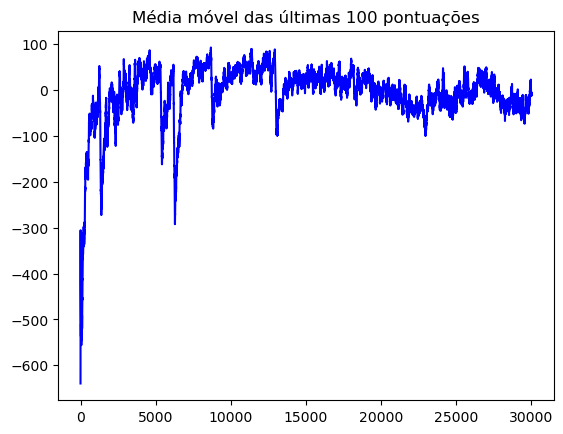

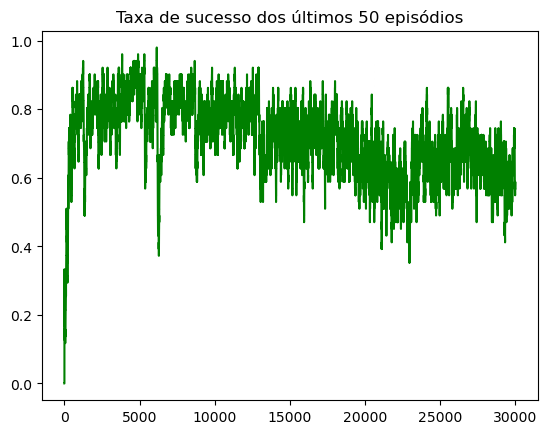

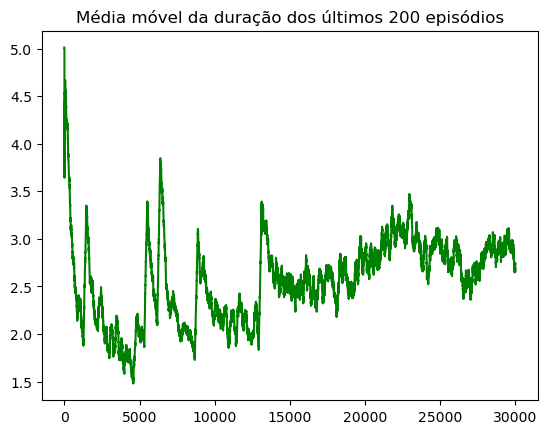

In [5]:
   ### RECOMPENSA DINÂMICA ###

# Hyperparameters
N_GAMES = 30001
MEM_SIZE = 100000
BATCH_SIZE = 32
TARGET_UPDATE = 6
GAMMA = 0.99
TAU = 0.005
LR = 1e-4

steps_taken = 0

if __name__ == '__main__':
    plt.ion()
    env = MujocoEnv2_1()
    state_dim = env.state_dim
    action_dim = env.action_dim
    agent = Agent(state_dim, action_dim)

    load = input("load from model? [y/n]: ")
    
    filename = 'DDQN_mujoco'
    figure_file_score = 'plots/' + filename + '_score.png'
    figure_file_catchrate = 'plots/' + filename + '_catchrate.png'
    figure_file_steps = 'plots/' + filename + '_steps.png'

    if load == "y":
        agent.main_model = load_model(agent.main_model, MODEL_FILE)
        agent.target_model = load_model(agent.main_model, MODEL_FILE)
        actions = load_actions(MODEL_FILE+'_actions')
        agent.eps = agent.eps_min

    max_score = -10000
    max_game = 0
    scores = []
    start = datetime.datetime.now()

    step_history = []
    score_history = []
    success_history = []
    partial_success_history = []
    next_level_points = []
    observable_games = [i for i in range(0, 30001, 500)]

    for game in range(N_GAMES):
        done = False
        score = 0
        success = 0
        observation = env.reset()
        #print(observation)
        game_actions = [] # actions taken during this game
        episode_start = datetime.datetime.now()

        if game not in observable_games:
            while not done:
                action = agent.choose_action(observation)
                next_observation, reward, done = env.step(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if reward > 0: success = 1
        else:
            while not done:
                action = agent.choose_action(observation)
                next_observation, reward, done = env.rstep(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if reward > 0: success = 1
            media.show_video(env.frames, fps=env.framerate)

        if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)


        # Update variables each game
        agent.decrement_epsilon()
        episode_end = datetime.datetime.now()
        elapsed = episode_end - episode_start
        scores.append(score)
        avg_score = np.mean(scores[-100:])
        
        step_history.append(env.tfin)
        score_history.append(score)
        success_history.append(success)
        partial_success_history.append(success)

        # Checks if the max score has been beaten
        if score > max_score:
            max_score = score
            max_game = game

            save_model(agent.main_model, MODEL_FILE)
            store_actions(game_actions, MODEL_FILE+'_actions')

        if len(partial_success_history)>600 and np.mean(partial_success_history[-100:])>0.9:
            partial_success_history = []
            env.setNextDistancia()
            agent.eps += 0.5
            next_level_points.append(game)
            max_score = -10000
            print('NEXT LEVEL')

        print("eps:",agent.eps)
        print('game:', game)
        print('reward:', str(score))
        print('average score for the last 100 games:', avg_score)
        print('partial success avg %.2f' %np.mean(partial_success_history[-100:]), ' dist %.2f' %env.dist)
        print('time:', str(elapsed.total_seconds()),'seconds')
        print()

    # After going through N_GAMES
    end = datetime.datetime.now()
    elapsed = end - start

    print('Total time:',elapsed.total_seconds(), 'seconds')
    
    x = [i+1 for i in range(N_GAMES)]
    %matplotlib inline
    plt.figure('learning')
    plot_learning_curve(x, score_history, figure_file_score)
    plt.figure('catching')
    plot_success_curve(x, success_history, figure_file_catchrate)
    plt.figure('steps')
    plot_step_curve(x, step_history, figure_file_steps)

    scores_file = open(MODEL_FILE+'_scores','wb')
    pickle.dump(scores, scores_file)
    scores_file.close()

In [8]:
'''
2*acao
512:256
self.e = 0.01  # Avoids priority 0
self.alpha = 0.5 # Priority control
self.beta = 0.3 # bias compensation
self.beta_increment = 0.00001
N_GAMES = 30001
MEM_SIZE = 100000
BATCH_SIZE = 32
TARGET_UPDATE = 6
GAMMA = 0.99
TAU = 0.005
LR = 1e-4
'''

'\n2*acao\n512:256\nself.e = 0.01  # Avoids priority 0\nself.alpha = 0.5 # Priority control\nself.beta = 0.3 # bias compensation\nself.beta_increment = 0.00001\nN_GAMES = 30001\nMEM_SIZE = 100000\nBATCH_SIZE = 32\nTARGET_UPDATE = 6\nGAMMA = 0.99\nTAU = 0.005\nLR = 1e-4\n'

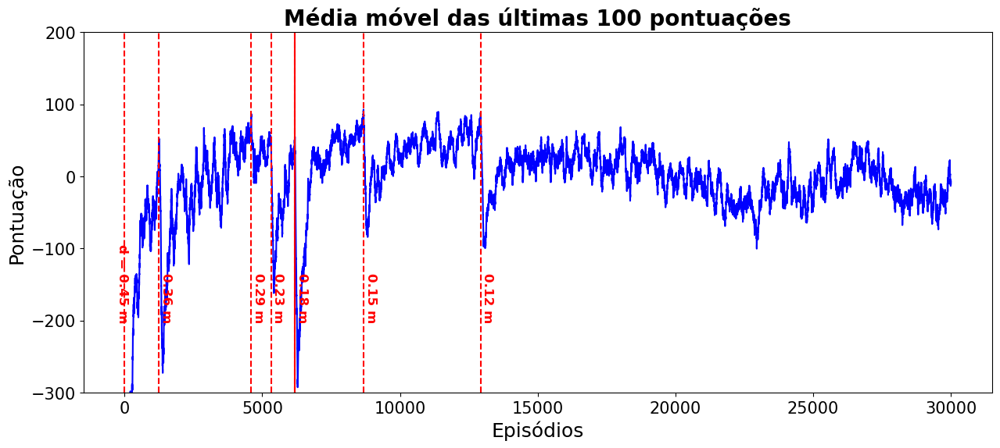

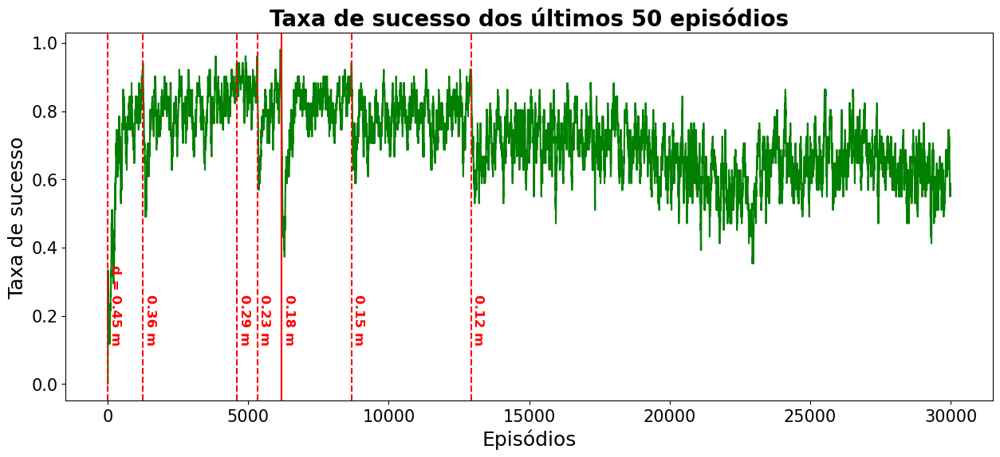

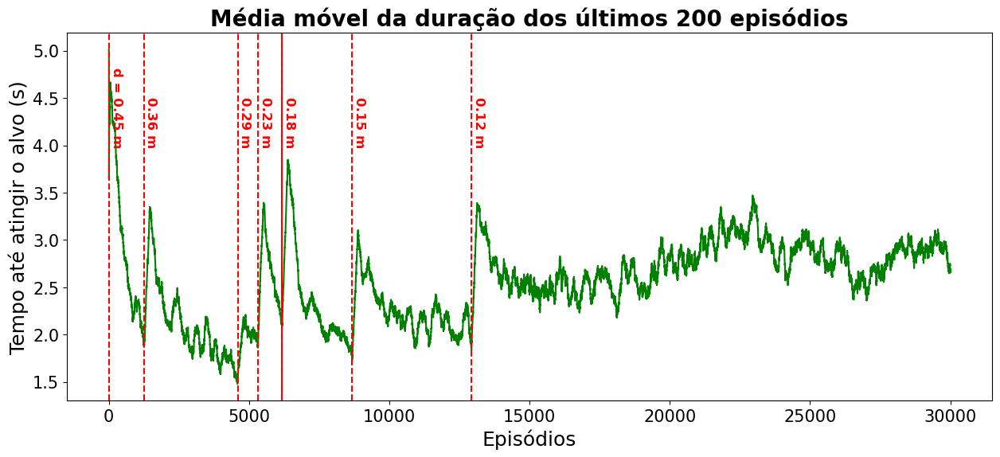

In [6]:
def plot_learning_curve(x, scores, figure_file):
    running_avg_score = np.zeros(len(scores))
    for i in range(len(running_avg_score)):
        running_avg_score[i] = np.mean(scores[max(0, i-100):(i+1)])
    plt.plot(x, running_avg_score, '-b')
    plt.ylim(-300,200)
    plt.xticks(fontsize='15')
    plt.yticks(fontsize='15')
    plt.xlabel('Episódios',fontsize='18')
    plt.ylabel('Pontuação',fontsize='18')
    plt.axvline(x=next_level_points[-3], color='red')
    plt.axvline(0,color='red',linestyle='--')
    plt.text(-300,-200,'d = 0.45 m',rotation=-90,color='red',weight='bold',size='12')
    d = 0.45
    for p in next_level_points[:]:
        d = d*0.8
        plt.text(p+50,-200,'%.2f m'%d,rotation=-90,color='red',weight='bold',size='12')
        plt.axvline(x=p, color='red', linestyle='--')
    plt.title('Média móvel das últimas 100 pontuações',size='20',weight='bold')
    plt.savefig(figure_file)

def plot_success_curve(x, successes, figure_file):
    running_success_rate = np.zeros(len(successes))
    for i in range(len(running_success_rate)):
        running_success_rate[i] = np.mean(successes[max(0, i-50):(i+1)])
    plt.plot(x, running_success_rate, '-g')
    plt.xticks(fontsize='15')
    plt.yticks(fontsize='15')
    plt.xlabel('Episódios',fontsize='18')
    plt.ylabel('Taxa de sucesso',fontsize='18')
    plt.axvline(x=next_level_points[-3], color='red')
    plt.axvline(0,color='red',linestyle='--')
    plt.text(65,0.12,'d = 0.45 m',rotation=-90,color='red',weight='bold',size='12')
    d = 0.45
    for p in next_level_points[:]:
        d = d*0.8
        plt.text(p+50,0.12,'%.2f m'%d,rotation=-90,color='red',weight='bold',size='12')
        plt.axvline(x=p, color='red', linestyle='--')
    plt.title('Taxa de sucesso dos últimos 50 episódios',size='20',weight='bold')
    plt.savefig(figure_file)

def plot_step_curve(x, steps, figure_file):
    running_step_avg = np.zeros(len(steps))
    for i in range(len(running_step_avg)):
        running_step_avg[i] = np.mean(steps[max(0, i-200):(i+1)])
    plt.plot(x, running_step_avg, '-g')
    plt.xticks(fontsize='15')
    plt.yticks(fontsize='15')
    plt.xlabel('Episódios',fontsize='18')
    plt.ylabel('Tempo até atingir o alvo (s)',fontsize='18')
    plt.axvline(x=next_level_points[-3], color='red')
    plt.axvline(0,color='red',linestyle='--')
    plt.text(65,4,'d = 0.45 m',rotation=-90,color='red',weight='bold',size='12')
    d = 0.45
    for p in next_level_points[:]:
        d = d*0.8
        plt.text(p+50,4,'%.2f m'%d,rotation=-90,color='red',weight='bold',size='12')
        plt.axvline(x=p, color='red', linestyle='--')
    plt.title('Média móvel da duração dos últimos 200 episódios',size='20',weight='bold')
    plt.savefig(figure_file)

x = [i+1 for i in range(30001)]
%matplotlib inline
plt.figure('learning',figsize=(15,6))
plot_learning_curve(x, score_history, figure_file_score)
plt.figure('catching',figsize=(15,6))
plot_success_curve(x, success_history, figure_file_catchrate)
plt.figure('steps',figsize=(15,6))
plot_step_curve(x, step_history, figure_file_steps)

In [ ]:
save_model(agent.main_model, MODEL_FILE)
store_actions(game_actions, MODEL_FILE+'_actions')

In [7]:
plt.ion()
env = MujocoEnv2_1()
state_dim = env.state_dim
action_dim = env.action_dim
agent = Agent(state_dim, action_dim)

agent.main_model = load_model(agent.main_model, MODEL_FILE)
agent.target_model = load_model(agent.main_model, MODEL_FILE)
actions = load_actions(MODEL_FILE+'_actions')
agent.eps = agent.eps_min

fixedGames = []
for i in np.arange(1, 1.5, 0.1):
    for j in np.arange(0, 2*np.pi, np.pi/18):
        list = [i, j] 
        fixedGames.append(list)

for game in range(len(fixedGames)):
    env.variaPos(float(fixedGames[game][0]),float(fixedGames[game][1]))
    done = False
    score = 0
    success = 0
    observation = env.resetFixo()
    game_actions = [] # actions taken during this game

    while not done:
        action = agent.choose_action(observation)
        next_observation, reward, done = env.rstep(action)
        action = torch.tensor(action).long()
        #agent.step(observation, action, reward, next_observation, done)
        score += float(reward)
        observation = next_observation
        #if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
        if reward > 0: success = 1
    media.show_video(env.frames, fps=env.framerate)

    print('Jogo:', game, ' \  Raio:', env.radius, ' \  Ângulo:', env.angle*180/np.pi)
    print('Recompensa:', str(score))
    print('-------------------------------------------------')


success


Jogo: 0  \  Raio: 1.0  \  Ângulo: 0.0
Recompensa: 158.0792745448907
-------------------------------------------------
success


Jogo: 1  \  Raio: 1.0  \  Ângulo: 10.0
Recompensa: 158.00797017742886
-------------------------------------------------
success


Jogo: 2  \  Raio: 1.0  \  Ângulo: 20.0
Recompensa: 158.17533227669867
-------------------------------------------------
success


Jogo: 3  \  Raio: 1.0  \  Ângulo: 29.999999999999996
Recompensa: 157.80063102865324
-------------------------------------------------
success


Jogo: 4  \  Raio: 1.0  \  Ângulo: 40.0
Recompensa: 150.4967890278069
-------------------------------------------------
success


Jogo: 5  \  Raio: 1.0  \  Ângulo: 50.0
Recompensa: 131.9674105452826
-------------------------------------------------
success


Jogo: 6  \  Raio: 1.0  \  Ângulo: 59.99999999999999
Recompensa: 151.1509418753472
-------------------------------------------------
success


Jogo: 7  \  Raio: 1.0  \  Ângulo: 70.0
Recompensa: 150.06417315200815
-------------------------------------------------
success


Jogo: 8  \  Raio: 1.0  \  Ângulo: 80.0
Recompensa: 144.8641500801028
-------------------------------------------------
success


Jogo: 9  \  Raio: 1.0  \  Ângulo: 90.0
Recompensa: 142.7398026005079
-------------------------------------------------
success


Jogo: 10  \  Raio: 1.0  \  Ângulo: 100.0
Recompensa: 122.22089813243963
-------------------------------------------------
success


Jogo: 11  \  Raio: 1.0  \  Ângulo: 110.0
Recompensa: 122.30112517252789
-------------------------------------------------
success


Jogo: 12  \  Raio: 1.0  \  Ângulo: 119.99999999999999
Recompensa: 103.60383645548376
-------------------------------------------------
success


Jogo: 13  \  Raio: 1.0  \  Ângulo: 130.0
Recompensa: 115.02075573069497
-------------------------------------------------
success


Jogo: 14  \  Raio: 1.0  \  Ângulo: 140.0
Recompensa: 109.2611951933142
-------------------------------------------------
success


Jogo: 15  \  Raio: 1.0  \  Ângulo: 150.00000000000003
Recompensa: 76.58920600247525
-------------------------------------------------
success


Jogo: 16  \  Raio: 1.0  \  Ângulo: 160.0
Recompensa: 87.7116441634169
-------------------------------------------------
success


Jogo: 17  \  Raio: 1.0  \  Ângulo: 170.0
Recompensa: 76.69820839846967
-------------------------------------------------
success


Jogo: 18  \  Raio: 1.0  \  Ângulo: 180.0
Recompensa: 63.53451385905399
-------------------------------------------------


Jogo: 19  \  Raio: 1.0  \  Ângulo: 190.0
Recompensa: -274.09013955560874
-------------------------------------------------
success


Jogo: 20  \  Raio: 1.0  \  Ângulo: 200.0
Recompensa: 43.33623860971659
-------------------------------------------------


Jogo: 21  \  Raio: 1.0  \  Ângulo: 209.99999999999997
Recompensa: -225.9270048555091
-------------------------------------------------


Jogo: 22  \  Raio: 1.0  \  Ângulo: 220.0
Recompensa: -217.4316935075641
-------------------------------------------------


Jogo: 23  \  Raio: 1.0  \  Ângulo: 229.99999999999997
Recompensa: -218.57163387720493
-------------------------------------------------
success


Jogo: 24  \  Raio: 1.0  \  Ângulo: 239.99999999999997
Recompensa: 76.95830273362256
-------------------------------------------------
success


Jogo: 25  \  Raio: 1.0  \  Ângulo: 249.99999999999997
Recompensa: 86.8929709007669
-------------------------------------------------
success


Jogo: 26  \  Raio: 1.0  \  Ângulo: 260.0
Recompensa: 88.43969600918479
-------------------------------------------------
success


Jogo: 27  \  Raio: 1.0  \  Ângulo: 270.0
Recompensa: 105.65241353090266
-------------------------------------------------
success


Jogo: 28  \  Raio: 1.0  \  Ângulo: 280.0
Recompensa: 119.9189042023445
-------------------------------------------------
success


Jogo: 29  \  Raio: 1.0  \  Ângulo: 290.0
Recompensa: 125.68176047664808
-------------------------------------------------
success


Jogo: 30  \  Raio: 1.0  \  Ângulo: 300.00000000000006
Recompensa: 140.2845478622483
-------------------------------------------------
success


Jogo: 31  \  Raio: 1.0  \  Ângulo: 310.0
Recompensa: 138.73740990811825
-------------------------------------------------
success


Jogo: 32  \  Raio: 1.0  \  Ângulo: 320.0
Recompensa: 122.5277574505847
-------------------------------------------------
success


Jogo: 33  \  Raio: 1.0  \  Ângulo: 329.99999999999994
Recompensa: 150.59460280309133
-------------------------------------------------
success


Jogo: 34  \  Raio: 1.0  \  Ângulo: 340.0
Recompensa: 146.21182273056587
-------------------------------------------------
success


Jogo: 35  \  Raio: 1.0  \  Ângulo: 350.00000000000006
Recompensa: 157.98565979969192
-------------------------------------------------
success


Jogo: 36  \  Raio: 1.1  \  Ângulo: 0.0
Recompensa: 163.51522211875567
-------------------------------------------------


Jogo: 37  \  Raio: 1.1  \  Ângulo: 10.0
Recompensa: -130.49596198038773
-------------------------------------------------


Jogo: 38  \  Raio: 1.1  \  Ângulo: 20.0
Recompensa: -129.13740475975354
-------------------------------------------------


Jogo: 39  \  Raio: 1.1  \  Ângulo: 29.999999999999996
Recompensa: -131.61642946640274
-------------------------------------------------


Jogo: 40  \  Raio: 1.1  \  Ângulo: 40.0
Recompensa: -135.7200289635231
-------------------------------------------------


Jogo: 41  \  Raio: 1.1  \  Ângulo: 50.0
Recompensa: -137.08461300599137
-------------------------------------------------
success


Jogo: 42  \  Raio: 1.1  \  Ângulo: 59.99999999999999
Recompensa: 153.77823292061902
-------------------------------------------------


Jogo: 43  \  Raio: 1.1  \  Ângulo: 70.0
Recompensa: -141.3539313366565
-------------------------------------------------


Jogo: 44  \  Raio: 1.1  \  Ângulo: 80.0
Recompensa: -145.173624158401
-------------------------------------------------
success


Jogo: 45  \  Raio: 1.1  \  Ângulo: 90.0
Recompensa: 142.62258993037923
-------------------------------------------------
success


Jogo: 46  \  Raio: 1.1  \  Ângulo: 100.0
Recompensa: 140.40061385847815
-------------------------------------------------
success


Jogo: 47  \  Raio: 1.1  \  Ângulo: 110.0
Recompensa: 92.4084500341932
-------------------------------------------------
success


Jogo: 48  \  Raio: 1.1  \  Ângulo: 119.99999999999999
Recompensa: 96.9978455539821
-------------------------------------------------
success


Jogo: 49  \  Raio: 1.1  \  Ângulo: 130.0
Recompensa: 117.88910642134908
-------------------------------------------------
success


Jogo: 50  \  Raio: 1.1  \  Ângulo: 140.0
Recompensa: 102.14112892162716
-------------------------------------------------
success


Jogo: 51  \  Raio: 1.1  \  Ângulo: 150.00000000000003
Recompensa: 65.6981495097736
-------------------------------------------------


Jogo: 52  \  Raio: 1.1  \  Ângulo: 160.0
Recompensa: -283.555545705653
-------------------------------------------------


Jogo: 53  \  Raio: 1.1  \  Ângulo: 170.0
Recompensa: -317.82039250684335
-------------------------------------------------
success


Jogo: 54  \  Raio: 1.1  \  Ângulo: 180.0
Recompensa: 41.87260924760102
-------------------------------------------------
success


Jogo: 55  \  Raio: 1.1  \  Ângulo: 190.0
Recompensa: 26.767665769364612
-------------------------------------------------


Jogo: 56  \  Raio: 1.1  \  Ângulo: 200.0
Recompensa: -214.53624932288486
-------------------------------------------------
success


Jogo: 57  \  Raio: 1.1  \  Ângulo: 209.99999999999997
Recompensa: 49.10076518975612
-------------------------------------------------


Jogo: 58  \  Raio: 1.1  \  Ângulo: 220.0
Recompensa: -227.63693325996567
-------------------------------------------------
success


Jogo: 59  \  Raio: 1.1  \  Ângulo: 229.99999999999997
Recompensa: 65.05678997338714
-------------------------------------------------


Jogo: 60  \  Raio: 1.1  \  Ângulo: 239.99999999999997
Recompensa: -192.43000680856196
-------------------------------------------------
success


Jogo: 61  \  Raio: 1.1  \  Ângulo: 249.99999999999997
Recompensa: 46.24816988840473
-------------------------------------------------
success


Jogo: 62  \  Raio: 1.1  \  Ângulo: 260.0
Recompensa: 100.25354405307596
-------------------------------------------------
success


Jogo: 63  \  Raio: 1.1  \  Ângulo: 270.0
Recompensa: 100.46385466660767
-------------------------------------------------
success


Jogo: 64  \  Raio: 1.1  \  Ângulo: 280.0
Recompensa: 109.19352379818977
-------------------------------------------------
success


Jogo: 65  \  Raio: 1.1  \  Ângulo: 290.0
Recompensa: 94.04023992967556
-------------------------------------------------


Jogo: 66  \  Raio: 1.1  \  Ângulo: 300.00000000000006
Recompensa: -142.85668889369066
-------------------------------------------------


Jogo: 67  \  Raio: 1.1  \  Ângulo: 310.0
Recompensa: -134.1800416210097
-------------------------------------------------


Jogo: 68  \  Raio: 1.1  \  Ângulo: 320.0
Recompensa: -132.72875761587318
-------------------------------------------------


Jogo: 69  \  Raio: 1.1  \  Ângulo: 329.99999999999994
Recompensa: -131.77214514584264
-------------------------------------------------


Jogo: 70  \  Raio: 1.1  \  Ângulo: 340.0
Recompensa: -132.82642630960254
-------------------------------------------------


Jogo: 71  \  Raio: 1.1  \  Ângulo: 350.00000000000006
Recompensa: -131.48999473544353
-------------------------------------------------
success


Jogo: 72  \  Raio: 1.2000000000000002  \  Ângulo: 0.0
Recompensa: 168.38960950876105
-------------------------------------------------
success


Jogo: 73  \  Raio: 1.2000000000000002  \  Ângulo: 10.0
Recompensa: 167.91770542714747
-------------------------------------------------
success


Jogo: 74  \  Raio: 1.2000000000000002  \  Ângulo: 20.0
Recompensa: 160.32181513392007
-------------------------------------------------


Jogo: 75  \  Raio: 1.2000000000000002  \  Ângulo: 29.999999999999996
Recompensa: -136.0799635754435
-------------------------------------------------


Jogo: 76  \  Raio: 1.2000000000000002  \  Ângulo: 40.0
Recompensa: -140.20570753121513
-------------------------------------------------


Jogo: 77  \  Raio: 1.2000000000000002  \  Ângulo: 50.0
Recompensa: -151.68467295578827
-------------------------------------------------


Jogo: 78  \  Raio: 1.2000000000000002  \  Ângulo: 59.99999999999999
Recompensa: -146.32066617202062
-------------------------------------------------
success


Jogo: 79  \  Raio: 1.2000000000000002  \  Ângulo: 70.0
Recompensa: 150.73760068087597
-------------------------------------------------


Jogo: 80  \  Raio: 1.2000000000000002  \  Ângulo: 80.0
Recompensa: -164.00226417732753
-------------------------------------------------


Jogo: 81  \  Raio: 1.2000000000000002  \  Ângulo: 90.0
Recompensa: -172.00727314496996
-------------------------------------------------


Jogo: 82  \  Raio: 1.2000000000000002  \  Ângulo: 100.0
Recompensa: -159.17537916477957
-------------------------------------------------


Jogo: 83  \  Raio: 1.2000000000000002  \  Ângulo: 110.0
Recompensa: -169.612288708263
-------------------------------------------------


Jogo: 84  \  Raio: 1.2000000000000002  \  Ângulo: 119.99999999999999
Recompensa: -171.6752213155547
-------------------------------------------------


Jogo: 85  \  Raio: 1.2000000000000002  \  Ângulo: 130.0
Recompensa: -183.32285438333793
-------------------------------------------------
success


Jogo: 86  \  Raio: 1.2000000000000002  \  Ângulo: 140.0
Recompensa: 102.56832099153941
-------------------------------------------------
success


Jogo: 87  \  Raio: 1.2000000000000002  \  Ângulo: 150.00000000000003
Recompensa: 65.71050958859269
-------------------------------------------------


Jogo: 88  \  Raio: 1.2000000000000002  \  Ângulo: 160.0
Recompensa: -274.8531478162497
-------------------------------------------------


Jogo: 89  \  Raio: 1.2000000000000002  \  Ângulo: 170.0
Recompensa: -282.0289265832282
-------------------------------------------------


Jogo: 90  \  Raio: 1.2000000000000002  \  Ângulo: 180.0
Recompensa: -319.8384569610284
-------------------------------------------------


Jogo: 91  \  Raio: 1.2000000000000002  \  Ângulo: 190.0
Recompensa: -257.9546056128556
-------------------------------------------------


Jogo: 92  \  Raio: 1.2000000000000002  \  Ângulo: 200.0
Recompensa: -214.31484209772688
-------------------------------------------------
success


Jogo: 93  \  Raio: 1.2000000000000002  \  Ângulo: 209.99999999999997
Recompensa: 81.75950847863139
-------------------------------------------------
success


Jogo: 94  \  Raio: 1.2000000000000002  \  Ângulo: 220.0
Recompensa: 69.38026670734624
-------------------------------------------------


Jogo: 95  \  Raio: 1.2000000000000002  \  Ângulo: 229.99999999999997
Recompensa: -191.67265454961168
-------------------------------------------------
success


Jogo: 96  \  Raio: 1.2000000000000002  \  Ângulo: 239.99999999999997
Recompensa: 92.34841939263386
-------------------------------------------------


Jogo: 97  \  Raio: 1.2000000000000002  \  Ângulo: 249.99999999999997
Recompensa: -174.70439712769135
-------------------------------------------------


Jogo: 98  \  Raio: 1.2000000000000002  \  Ângulo: 260.0
Recompensa: -171.93021497046695
-------------------------------------------------
success


Jogo: 99  \  Raio: 1.2000000000000002  \  Ângulo: 270.0
Recompensa: 120.78103922255438
-------------------------------------------------
success


Jogo: 100  \  Raio: 1.2000000000000002  \  Ângulo: 280.0
Recompensa: 130.591179772635
-------------------------------------------------
success


Jogo: 101  \  Raio: 1.2000000000000002  \  Ângulo: 290.0
Recompensa: 138.6893330934816
-------------------------------------------------


Jogo: 102  \  Raio: 1.2000000000000002  \  Ângulo: 300.00000000000006
Recompensa: -140.8868358501787
-------------------------------------------------


Jogo: 103  \  Raio: 1.2000000000000002  \  Ângulo: 310.0
Recompensa: -136.27805025352325
-------------------------------------------------


Jogo: 104  \  Raio: 1.2000000000000002  \  Ângulo: 320.0
Recompensa: -139.82624882746498
-------------------------------------------------


Jogo: 105  \  Raio: 1.2000000000000002  \  Ângulo: 329.99999999999994
Recompensa: -143.09228284946238
-------------------------------------------------


Jogo: 106  \  Raio: 1.2000000000000002  \  Ângulo: 340.0
Recompensa: -154.892024112012
-------------------------------------------------
success


Jogo: 107  \  Raio: 1.2000000000000002  \  Ângulo: 350.00000000000006
Recompensa: 162.17237712940042
-------------------------------------------------


Jogo: 108  \  Raio: 1.3000000000000003  \  Ângulo: 0.0
Recompensa: -138.47170169379177
-------------------------------------------------


Jogo: 109  \  Raio: 1.3000000000000003  \  Ângulo: 10.0
Recompensa: -137.75086122943472
-------------------------------------------------


Jogo: 110  \  Raio: 1.3000000000000003  \  Ângulo: 20.0
Recompensa: -135.87468310127264
-------------------------------------------------


Jogo: 111  \  Raio: 1.3000000000000003  \  Ângulo: 29.999999999999996
Recompensa: -138.86603166268347
-------------------------------------------------


Jogo: 112  \  Raio: 1.3000000000000003  \  Ângulo: 40.0
Recompensa: -151.19932601665604
-------------------------------------------------


Jogo: 113  \  Raio: 1.3000000000000003  \  Ângulo: 50.0
Recompensa: -160.43258329743114
-------------------------------------------------
success


Jogo: 114  \  Raio: 1.3000000000000003  \  Ângulo: 59.99999999999999
Recompensa: 159.23910120086578
-------------------------------------------------
success


Jogo: 115  \  Raio: 1.3000000000000003  \  Ângulo: 70.0
Recompensa: 158.84998813147962
-------------------------------------------------
success


Jogo: 116  \  Raio: 1.3000000000000003  \  Ângulo: 80.0
Recompensa: 151.54426919001497
-------------------------------------------------
success


Jogo: 117  \  Raio: 1.3000000000000003  \  Ângulo: 90.0
Recompensa: 116.69047663332724
-------------------------------------------------


Jogo: 118  \  Raio: 1.3000000000000003  \  Ângulo: 100.0
Recompensa: -161.64259184626687
-------------------------------------------------


Jogo: 119  \  Raio: 1.3000000000000003  \  Ângulo: 110.0
Recompensa: -171.74263204490114
-------------------------------------------------


Jogo: 120  \  Raio: 1.3000000000000003  \  Ângulo: 119.99999999999999
Recompensa: -183.53593719756216
-------------------------------------------------


Jogo: 121  \  Raio: 1.3000000000000003  \  Ângulo: 130.0
Recompensa: -192.091948753915
-------------------------------------------------


Jogo: 122  \  Raio: 1.3000000000000003  \  Ângulo: 140.0
Recompensa: -194.40202213826635
-------------------------------------------------
success


Jogo: 123  \  Raio: 1.3000000000000003  \  Ângulo: 150.00000000000003
Recompensa: 34.5518925613662
-------------------------------------------------
success


Jogo: 124  \  Raio: 1.3000000000000003  \  Ângulo: 160.0
Recompensa: 41.27447083640675
-------------------------------------------------


Jogo: 125  \  Raio: 1.3000000000000003  \  Ângulo: 170.0
Recompensa: -261.1720551412222
-------------------------------------------------


Jogo: 126  \  Raio: 1.3000000000000003  \  Ângulo: 180.0
Recompensa: -290.299989586643
-------------------------------------------------
success


Jogo: 127  \  Raio: 1.3000000000000003  \  Ângulo: 190.0
Recompensa: 52.886651219427876
-------------------------------------------------
success


Jogo: 128  \  Raio: 1.3000000000000003  \  Ângulo: 200.0
Recompensa: 69.66985690148726
-------------------------------------------------
success


Jogo: 129  \  Raio: 1.3000000000000003  \  Ângulo: 209.99999999999997
Recompensa: 85.44307474553958
-------------------------------------------------
success


Jogo: 130  \  Raio: 1.3000000000000003  \  Ângulo: 220.0
Recompensa: 91.41850535763442
-------------------------------------------------


Jogo: 131  \  Raio: 1.3000000000000003  \  Ângulo: 229.99999999999997
Recompensa: -185.67084389362955
-------------------------------------------------


Jogo: 132  \  Raio: 1.3000000000000003  \  Ângulo: 239.99999999999997
Recompensa: -190.34048095762384
-------------------------------------------------


Jogo: 133  \  Raio: 1.3000000000000003  \  Ângulo: 249.99999999999997
Recompensa: -172.86307240886177
-------------------------------------------------


Jogo: 134  \  Raio: 1.3000000000000003  \  Ângulo: 260.0
Recompensa: -171.63428334365975
-------------------------------------------------


Jogo: 135  \  Raio: 1.3000000000000003  \  Ângulo: 270.0
Recompensa: -158.8905438910491
-------------------------------------------------
success


Jogo: 136  \  Raio: 1.3000000000000003  \  Ângulo: 280.0
Recompensa: 128.3289516697055
-------------------------------------------------
success


Jogo: 137  \  Raio: 1.3000000000000003  \  Ângulo: 290.0
Recompensa: 124.97597911350304
-------------------------------------------------
success


Jogo: 138  \  Raio: 1.3000000000000003  \  Ângulo: 300.00000000000006
Recompensa: 149.07741171154035
-------------------------------------------------


Jogo: 139  \  Raio: 1.3000000000000003  \  Ângulo: 310.0
Recompensa: -139.52818247114203
-------------------------------------------------


Jogo: 140  \  Raio: 1.3000000000000003  \  Ângulo: 320.0
Recompensa: -146.35307067363965
-------------------------------------------------


Jogo: 141  \  Raio: 1.3000000000000003  \  Ângulo: 329.99999999999994
Recompensa: -135.50751846229426
-------------------------------------------------


Jogo: 142  \  Raio: 1.3000000000000003  \  Ângulo: 340.0
Recompensa: -158.12357893501132
-------------------------------------------------
success


Jogo: 143  \  Raio: 1.3000000000000003  \  Ângulo: 350.00000000000006
Recompensa: 170.21899306884518
-------------------------------------------------
success


Jogo: 144  \  Raio: 1.4000000000000004  \  Ângulo: 0.0
Recompensa: 177.3915185643237
-------------------------------------------------
success


Jogo: 145  \  Raio: 1.4000000000000004  \  Ângulo: 10.0
Recompensa: 169.2877923335318
-------------------------------------------------
success


Jogo: 146  \  Raio: 1.4000000000000004  \  Ângulo: 20.0
Recompensa: 177.25692995861286
-------------------------------------------------


Jogo: 147  \  Raio: 1.4000000000000004  \  Ângulo: 29.999999999999996
Recompensa: -156.3853014135781
-------------------------------------------------


Jogo: 148  \  Raio: 1.4000000000000004  \  Ângulo: 40.0
Recompensa: -159.75310925667068
-------------------------------------------------


Jogo: 149  \  Raio: 1.4000000000000004  \  Ângulo: 50.0
Recompensa: -173.54178558315058
-------------------------------------------------


Jogo: 150  \  Raio: 1.4000000000000004  \  Ângulo: 59.99999999999999
Recompensa: -160.21371689634307
-------------------------------------------------
success


Jogo: 151  \  Raio: 1.4000000000000004  \  Ângulo: 70.0
Recompensa: 156.67277921901794
-------------------------------------------------
success


Jogo: 152  \  Raio: 1.4000000000000004  \  Ângulo: 80.0
Recompensa: 153.64624539732492
-------------------------------------------------
success


Jogo: 153  \  Raio: 1.4000000000000004  \  Ângulo: 90.0
Recompensa: 120.93495191409251
-------------------------------------------------


Jogo: 154  \  Raio: 1.4000000000000004  \  Ângulo: 100.0
Recompensa: -163.45603702371977
-------------------------------------------------


Jogo: 155  \  Raio: 1.4000000000000004  \  Ângulo: 110.0
Recompensa: -165.26209560684876
-------------------------------------------------


Jogo: 156  \  Raio: 1.4000000000000004  \  Ângulo: 119.99999999999999
Recompensa: -175.48731033002167
-------------------------------------------------


Jogo: 157  \  Raio: 1.4000000000000004  \  Ângulo: 130.0
Recompensa: -193.78574989790897
-------------------------------------------------
success


Jogo: 158  \  Raio: 1.4000000000000004  \  Ângulo: 140.0
Recompensa: 83.44819415540812
-------------------------------------------------
success


Jogo: 159  \  Raio: 1.4000000000000004  \  Ângulo: 150.00000000000003
Recompensa: 67.30150414464848
-------------------------------------------------
success


Jogo: 160  \  Raio: 1.4000000000000004  \  Ângulo: 160.0
Recompensa: 46.41101027342904
-------------------------------------------------


Jogo: 161  \  Raio: 1.4000000000000004  \  Ângulo: 170.0
Recompensa: -257.756020814395
-------------------------------------------------
success


Jogo: 162  \  Raio: 1.4000000000000004  \  Ângulo: 180.0
Recompensa: -56.565618220860216
-------------------------------------------------
success


Jogo: 163  \  Raio: 1.4000000000000004  \  Ângulo: 190.0
Recompensa: 22.030510855797303
-------------------------------------------------


Jogo: 164  \  Raio: 1.4000000000000004  \  Ângulo: 200.0
Recompensa: -224.15629344139083
-------------------------------------------------
success


Jogo: 165  \  Raio: 1.4000000000000004  \  Ângulo: 209.99999999999997
Recompensa: 46.244733657668604
-------------------------------------------------


Jogo: 166  \  Raio: 1.4000000000000004  \  Ângulo: 220.0
Recompensa: -216.15732605148153
-------------------------------------------------


Jogo: 167  \  Raio: 1.4000000000000004  \  Ângulo: 229.99999999999997
Recompensa: -190.15660324151648
-------------------------------------------------


Jogo: 168  \  Raio: 1.4000000000000004  \  Ângulo: 239.99999999999997
Recompensa: -184.08145948425513
-------------------------------------------------


Jogo: 169  \  Raio: 1.4000000000000004  \  Ângulo: 249.99999999999997
Recompensa: -181.75330751663049
-------------------------------------------------
success


Jogo: 170  \  Raio: 1.4000000000000004  \  Ângulo: 260.0
Recompensa: 120.40284931228982
-------------------------------------------------
success


Jogo: 171  \  Raio: 1.4000000000000004  \  Ângulo: 270.0
Recompensa: 107.02141296786259
-------------------------------------------------
success


Jogo: 172  \  Raio: 1.4000000000000004  \  Ângulo: 280.0
Recompensa: 132.534391688053
-------------------------------------------------
success


Jogo: 173  \  Raio: 1.4000000000000004  \  Ângulo: 290.0
Recompensa: 148.252241965387
-------------------------------------------------


Jogo: 174  \  Raio: 1.4000000000000004  \  Ângulo: 300.00000000000006
Recompensa: -145.34755496151982
-------------------------------------------------


Jogo: 175  \  Raio: 1.4000000000000004  \  Ângulo: 310.0
Recompensa: -143.42349037141682
-------------------------------------------------


Jogo: 176  \  Raio: 1.4000000000000004  \  Ângulo: 320.0
Recompensa: -134.79932289858738
-------------------------------------------------


Jogo: 177  \  Raio: 1.4000000000000004  \  Ângulo: 329.99999999999994
Recompensa: -141.07463477813914
-------------------------------------------------


Jogo: 178  \  Raio: 1.4000000000000004  \  Ângulo: 340.0
Recompensa: -140.42143048714604
-------------------------------------------------
success


Jogo: 179  \  Raio: 1.4000000000000004  \  Ângulo: 350.00000000000006
Recompensa: 176.82280712266336
-------------------------------------------------
